In [1]:
suppressMessages(library(ggplot2))
suppressMessages(library(ArchR))
suppressMessages(library(Seurat))
suppressMessages(library(Signac))

In [2]:
set.seed(42)
addArchRThreads(threads = 64)

Setting default number of Parallel threads to 64.



In [3]:
proj <- loadArchRProject("./ArchRProject", showLogo = FALSE)

Successfully loaded ArchRProject!



### Annotation cellType
从scATAC-seq注释主要细胞类型，分别可视化各个细胞类型的marker
9种主要细胞类型：
 - 上皮细胞 `epithelial cells`
 - 内皮细胞 `endothelial cells`
 - 免疫细胞 `immune cells`
    - T细胞 `T cells`
    - B细胞 `B cells`
    - 髓系细胞 `myeloid cells`
    - 肥大细胞 `mast cells`
    - 浆母细胞 `plasmablasts`
 - 间充质细胞 `mesenchymal cells`
    - 成纤维细胞 `fibroblasts`
    - 血管周围样细胞 `perivascular-like cells`

---
新scRNA-seq注释主要细胞类型，分别可视化各个细胞类型的marker
主要细胞类型：
 - `Epithelial`
 - `CD4T cells`
 - `CD8T & NK cells`
 - `Fibroblast`
 - `Endothelial`
 - `Myeloid`
 - `Pericyte`
 - `Basal`
 - `Smooth muscle`
 - `B cells`
 - `Plasmablast`
 - `Ery & Endo mixed`
 - `Mast`
 - `pDC`
 - `Plasma cells`


In [4]:
markersGS <- readRDS("./ArchRProject/markersGS.rds")

ArchR logging to : ArchRLogs/ArchR-plotMarkerHeatmap-28dc823288d39e-Date-2025-02-25_Time-01-57-52.331522.log
If there is an issue, please report to github with logFile!

Printing Top Marker Genes:

C1:

	TMEM240, ARHGEF16, TNFRSF25, UBXN10, CAMK2N1, SERINC2, LINC01226, ARTN, KNCN, CYP4A22, HOOK1, RNVU1-15, NBPF20, GPR89A, PDZK1

C2:

	CELA2B, FAM131C, LOC284632, SLC30A2, GUCA2A, CYP4Z1, RAB3B, TTC22, LEXM, OVGP1, MAB21L3, LINGO4, ATP1A2, ATP1A4, C1orf105

C3:

	CASQ1, OR6F1, OR1C1, PCDH20, FAM174B, LINC00923, ARRDC4, LINC01582, FAM169B, IGF1R, MIR4714, PGPEP1L, SYNM, TTC23, HSP90B2P

C4:

	CDA, BEND5, PRKAA2, SLC44A5, AK5, LINC01555, GBP7, HAO2-IT1, KCNMA1-AS3, CUZD1, TCERG1L-AS1, TPH1, MIR1252, LINC02410, SLITRK6

C5:

	MIR6727, LINC01351, TRIM6, RAG2, YEATS4, LOC101928002, RAB3IP, LOC100130238, LINC00359, SERPINA6, MEG9, SULT1A1, SGK494, SPAG5-AS1, KIAA0100

C6:

	CCDC190, LOC101926942, FRG2B, ARNTL2-AS1, PCDH9-AS3, BAG5, MRPL12, LINC01882, DSG2-AS1, STARD6, LINC01538, GTSCR1, LINC01

 [1] "CD38"   "IGLL5"  "PAX5"   "ITGAM"  "FAP"    "FOXP3"  "VIM"    "PDCD1" 
 [9] "CD8A"   "CD3D"   "CD4"    "CXCL12" "THY1"   "PECAM1" "KDR"    "EPACM" 
[17] "ERBB2"  "FOXA1"  "KRT8"   "ESR1"   "KRT14"  "ERBB4"  "CDH8"  


Preparing Main Heatmap..

'magick' package is suggested to install to give better rasterization.

Set `ht_opt$message = FALSE` to turn off this message.

ArchR logging successful to : ArchRLogs/ArchR-plotMarkerHeatmap-28dc823288d39e-Date-2025-02-25_Time-01-57-52.331522.log



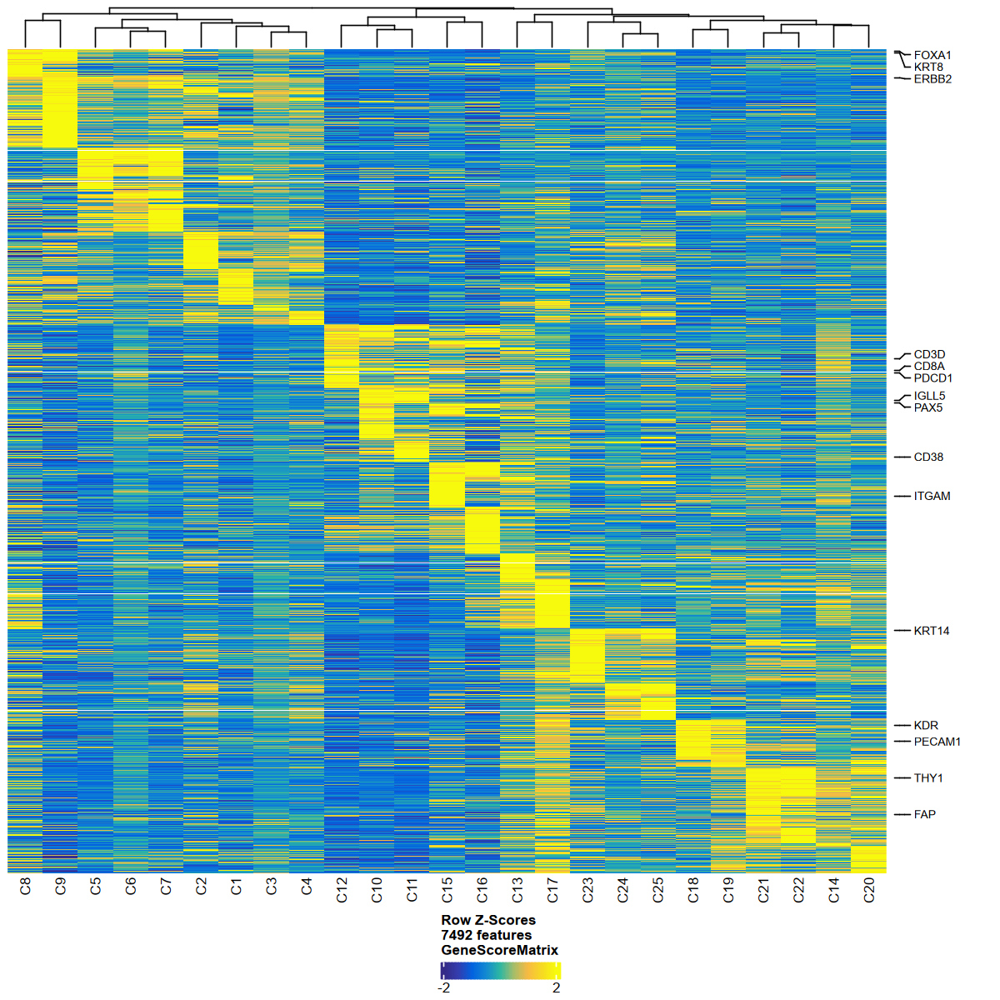

In [11]:
# Heatmap
## marker genes, 根据05_01_annotation中的显著表达来确定绘图的marker genes
markerGenes <- c(
    "CD38", "IGLL5", "PAX5", "ITGAM", "FAP",
    "FOXP3", "VIM", "PDCD1", "CD8A", "CD3D",
    "CD4", "CXCL12", "THY1", "PECAM1", "KDR",
    "EPACM", "ERBB2", "FOXA1", "KRT8", "ESR1",
    "KRT14",
    "ERBB4", "CDH8"
)

heatmapGS <- plotMarkerHeatmap(
  seMarker = markersGS, 
  cutOff = "FDR <= 0.05 & Log2FC >= 1.25", 
  labelMarkers = markerGenes
)

options(repr.plot.height = 10, repr.plot.width = 10)

ComplexHeatmap::draw(heatmapGS, 
                     heatmap_legend_side = "bot", 
                     annotation_legend_side = "bot",
                     show_row_dend = FALSE)

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc8255b22914-Date-2025-02-25_Time-01-58-05.340182.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 01:58:05.565837 : 





Plotting Embedding

1 
2 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc8255b22914-Date-2025-02-25_Time-01-58-05.340182.log

Warning message:
“The `<scale>` argument of `guides()` cannot be `FALSE`. Use "none" instead as
of ggplot2 3.3.4.”


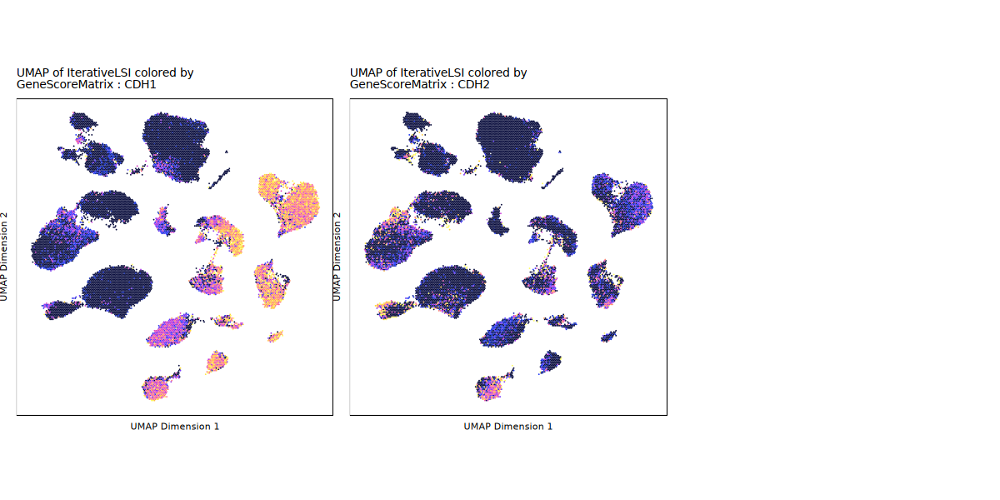

In [12]:
# markerGenes - EMT，应该升高的基因
markerGenes <- c(
    "CDH1", "CDH2"
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 5, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc826844b669-Date-2025-02-25_Time-01-58-13.033827.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 01:58:13.42928 : 





Plotting Embedding

1 
2 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc826844b669-Date-2025-02-25_Time-01-58-13.033827.log



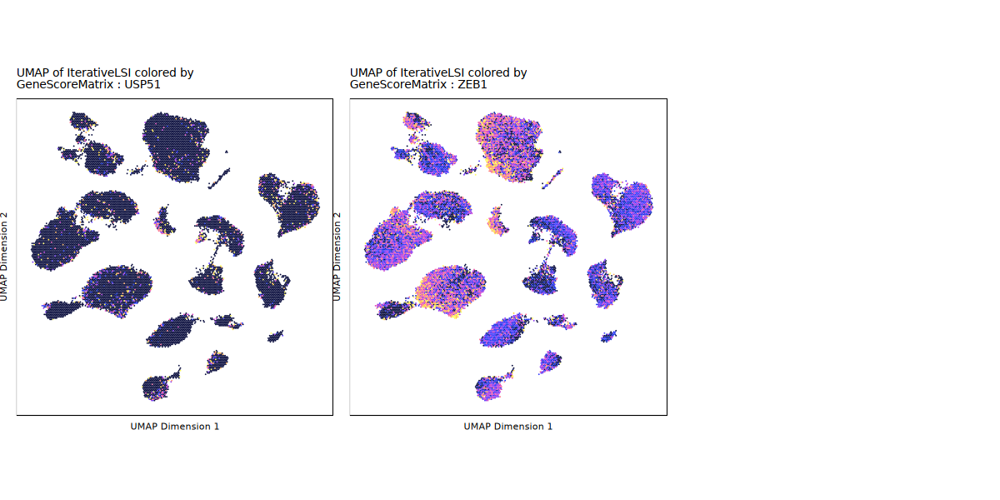

In [13]:
# markerGenes - EMT，应该升高的基因
markerGenes <- c(
    "USP51", "ZEB1"
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 5, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc821b90ff36-Date-2025-02-25_Time-01-58-21.186535.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 01:58:21.395504 : 



Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 
9 
10 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc821b90ff36-Date-2025-02-25_Time-01-58-21.186535.log



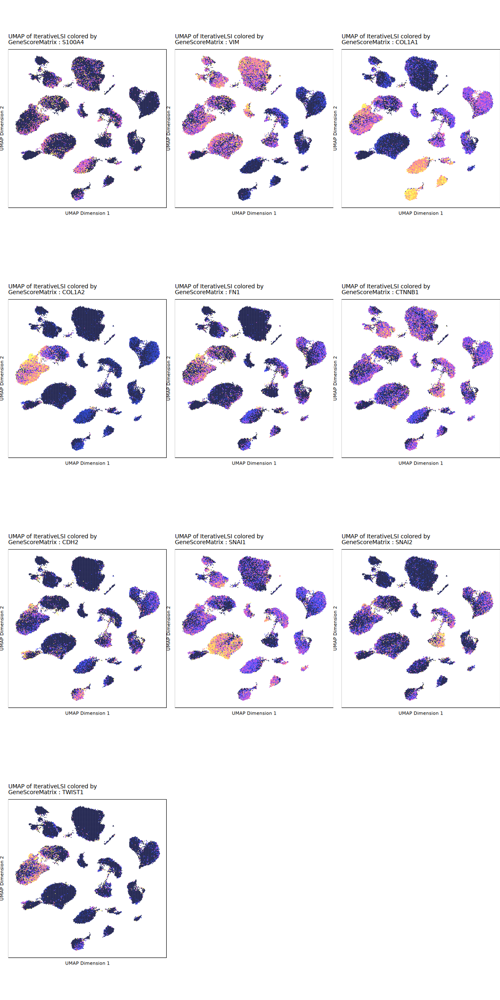

In [14]:
# markerGenes - EMT，应该升高的基因
markerGenes <- c(
    "S100A4", "VIM", "COL1A1", "COL1A2", "FN1",
    "CTNNB1", "CDH2", 
    "SNAI1", "SNAI2", "TWIST1"
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 20, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc8245f3476b-Date-2025-02-25_Time-01-58-57.011496.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 01:58:57.67924 : 



Plotting Embedding

1 
2 
3 
4 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc8245f3476b-Date-2025-02-25_Time-01-58-57.011496.log



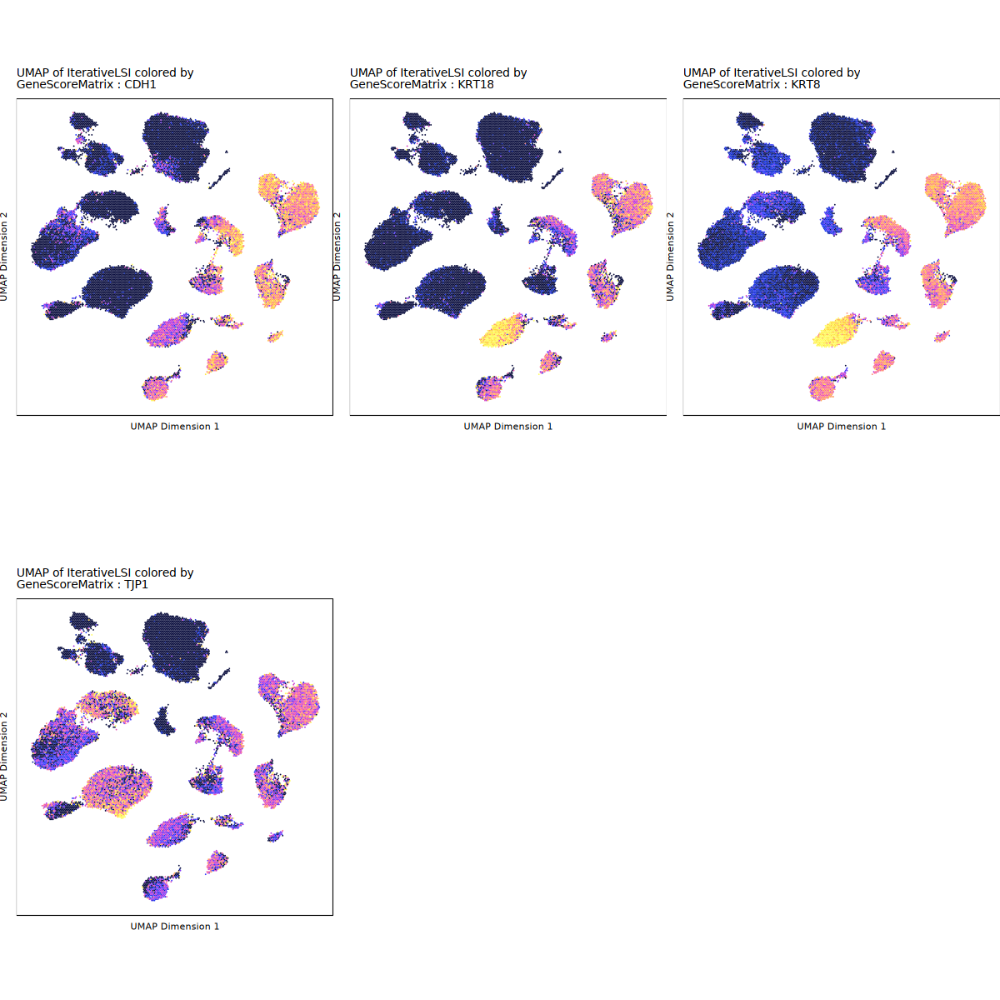

In [15]:
# markerGenes - EMT应该下降的基因
markerGenes <- c(
    "CDH1","KRT18", "KRT8", "TJP1"
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc824b84d903-Date-2025-02-25_Time-01-59-11.238175.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 01:59:11.463127 : 



Plotting Embedding

1 
2 
3 
4 
5 
6 
7 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc824b84d903-Date-2025-02-25_Time-01-59-11.238175.log



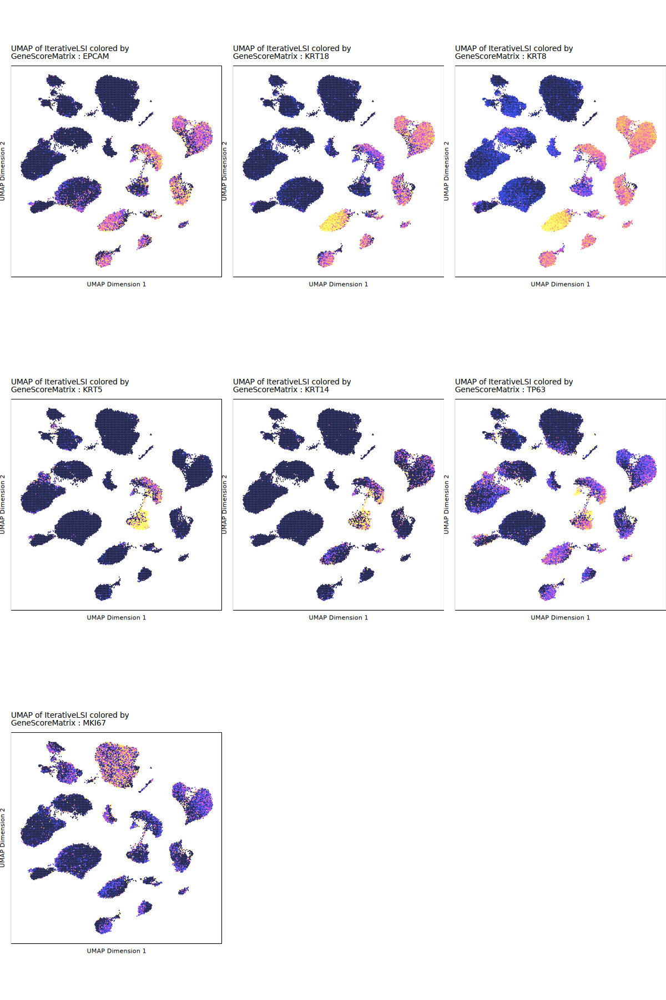

In [16]:
# markerGenes - Epithelial上皮，活跃上皮marker
markerGenes <- c(
    "EPCAM","KRT18", "KRT8", "KRT5", "KRT14", "TP63", "MKI67"
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 15, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-7ea495cd49ee6-Date-2025-03-05_Time-12-48-55.261795.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-03-05 12:48:59.450146 : 



Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 
9 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-7ea495cd49ee6-Date-2025-03-05_Time-12-48-55.261795.log

Warning message:
“The `<scale>` argument of `guides()` cannot be `FALSE`. Use "none" instead as
of ggplot2 3.3.4.”


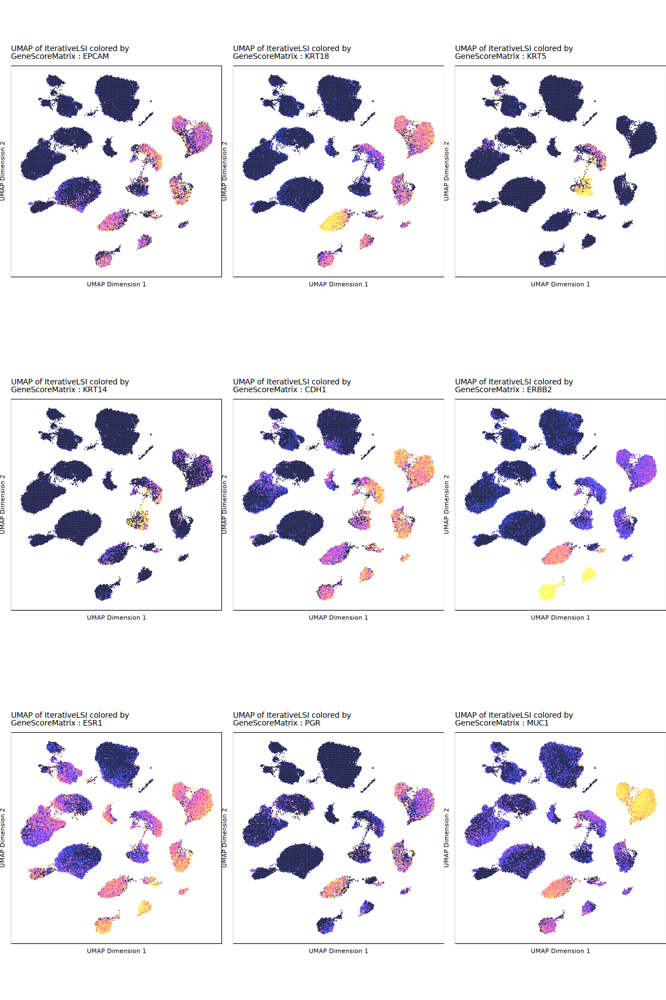

In [5]:
# markerGenes - Epithelial上皮，05_01中的marker（常规验证的marker）
markerGenes <- c(
    "EPCAM","KRT18", "KRT5", "KRT14", "CDH1", "ERBB2", "ESR1", "PGR", "MUC1" 
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 15, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

In [6]:
plotPDF(plotList = p, 
    name = "Plot-UMAP-Marker-Genes-Epithelial.pdf", 
    ArchRProj = proj, 
    addDOC = FALSE, width = 5, height = 5)

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!



ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc8222fb73ea-Date-2025-02-25_Time-02-00-09.147835.log
If there is an issue, please report to github with logFile!



Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:00:09.889283 : 



Plotting Embedding

1 
2 
3 
4 
5 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc8222fb73ea-Date-2025-02-25_Time-02-00-09.147835.log



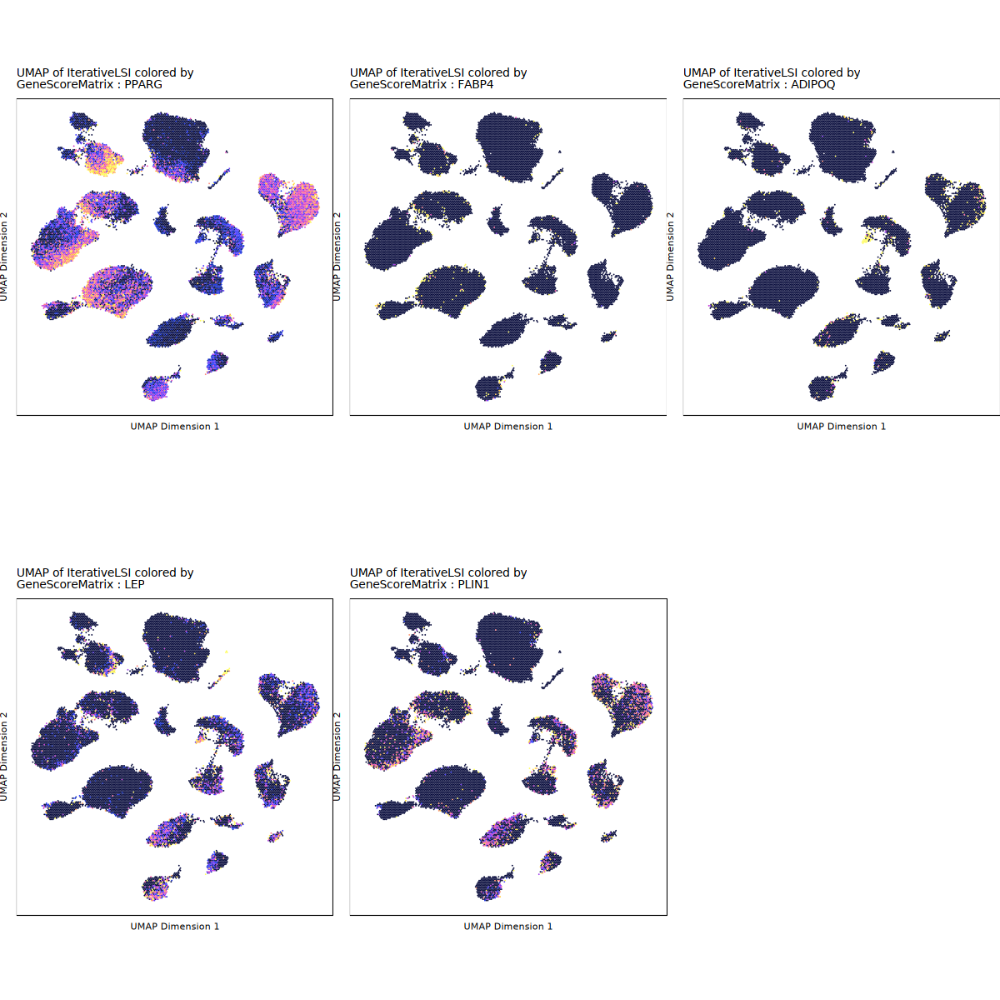

In [18]:
# markerGenes - 脂肪细胞marker
markerGenes <- c(
    "PPARG", "FABP4", "ADIPOQ", "LEP", "PLIN1"
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

C15 簇差异基因
EGFR：表皮生长因子受体，和上皮细胞有关。
ERBB4：编码表皮生长因子家族中受体酪氨酸激酶的基因，和上皮细胞有关。


ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc823c406847-Date-2025-02-25_Time-02-00-28.944614.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:00:29.17024 : 



Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 
9 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc823c406847-Date-2025-02-25_Time-02-00-28.944614.log



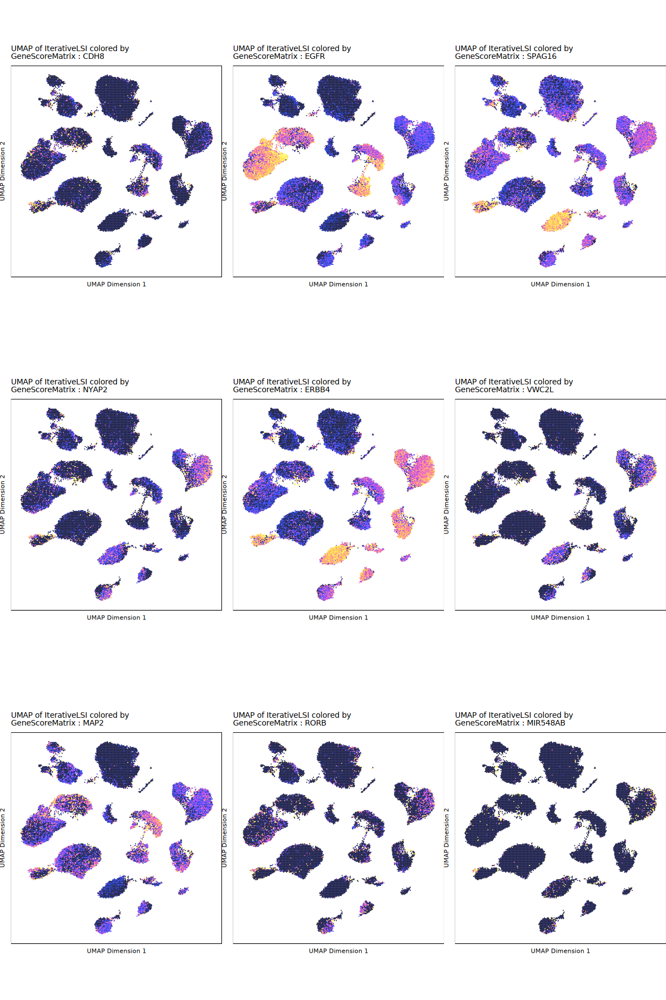

In [19]:
# markerGenes - C15差异基因
markerGenes <- c(
    "CDH8", "EGFR", "SPAG16", "NYAP2", "ERBB4", "VWC2L", "MAP2", "RORB", "MIR548AB"
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 15, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

### Annotation cellType
从scATAC-seq注释主要细胞类型，分别可视化各个细胞类型的marker
9种主要细胞类型：
 - 上皮细胞 `epithelial cells`
 - 内皮细胞 `endothelial cells`
 - 免疫细胞 `immune cells`
    - T细胞 `T cells`
    - B细胞 `B cells`
    - 髓系细胞 `myeloid cells`
    - 肥大细胞 `mast cells`
    - 浆母细胞 `plasmablasts`
 - 间充质细胞 `mesenchymal cells`
    - 成纤维细胞 `fibroblasts`
    - 血管周围样细胞 `perivascular-like cells`

In [20]:
# markerGenes - Epithelial上皮
markerGenes <- c(
    "EPCAM","KRT18", "KRT5", "KRT14", "CDH1", "ERBB2", "ESR1", "PGR", "MUC1" 
)

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc8219b24323-Date-2025-02-25_Time-02-00-53.732065.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:00:53.964035 : 





Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 
9 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc8219b24323-Date-2025-02-25_Time-02-00-53.732065.log



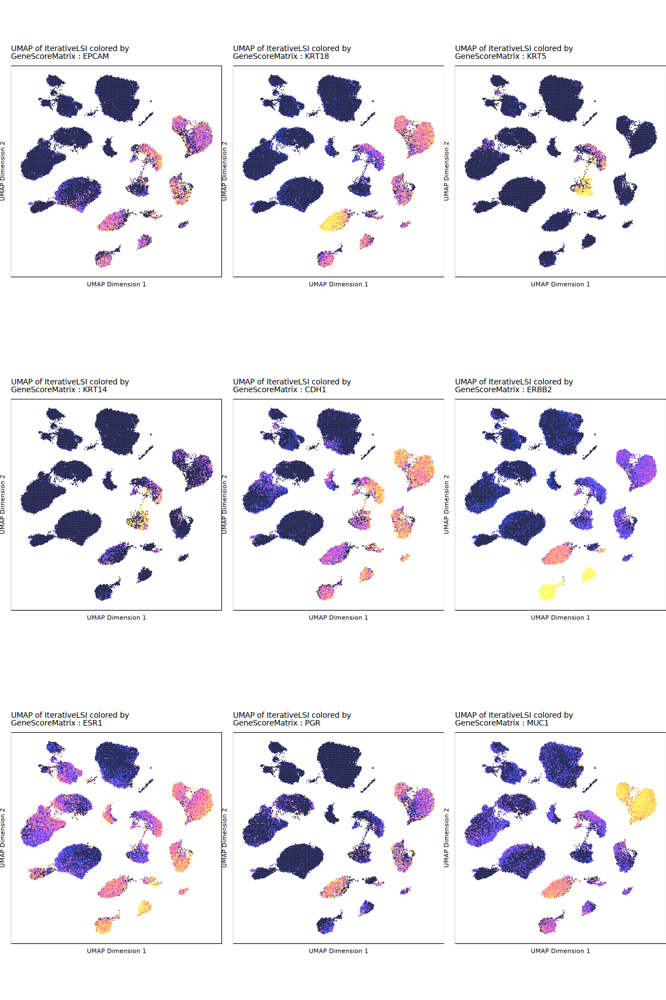

In [21]:
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 15, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

Getting ImputeWeights

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc82c4f3268-Date-2025-02-25_Time-02-01-26.673861.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:01:27.270927 : 



Imputing Matrix

Using weights on disk

Using weights on disk

Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 
9 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc82c4f3268-Date-2025-02-25_Time-02-01-26.673861.log



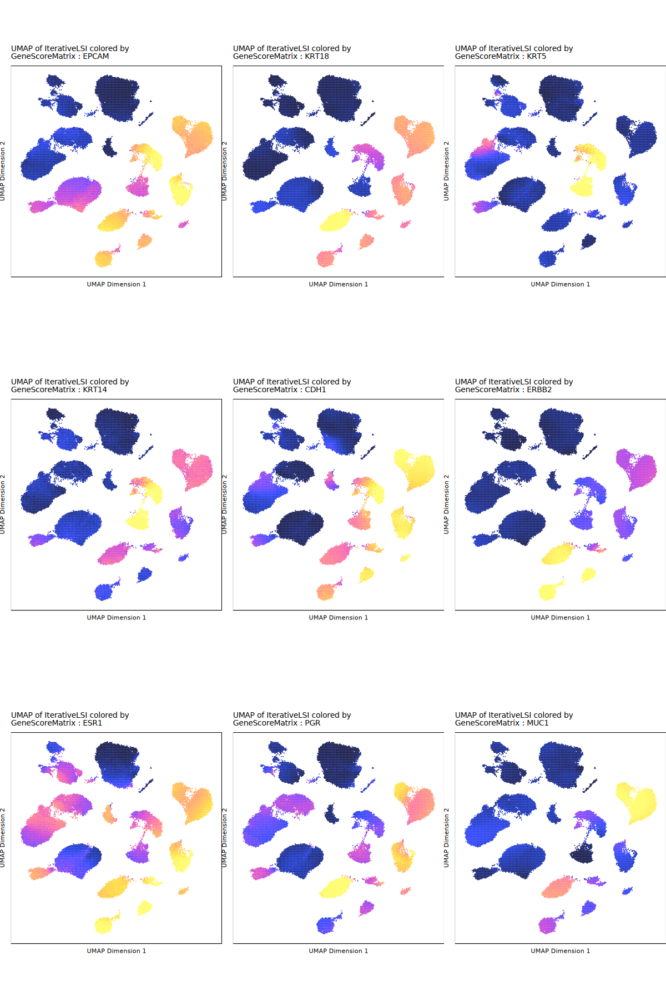

In [22]:
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = getImputeWeights(proj)
)
options(repr.plot.height = 15, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

In [7]:
# markerGenes - Fibroblast成纤维细胞
markerGenes <- c(
    "CXCL12", "THY1", "S100A4", "VIM", "PDGFRB", "COL1A1", "COL3A1", "FAP", "CKAP4"
)

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-7ea4949ae4c7f-Date-2025-03-05_Time-12-52-09.099506.log
If there is an issue, please report to github with logFile!



Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-03-05 12:52:09.531634 : 



Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 
9 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-7ea4949ae4c7f-Date-2025-03-05_Time-12-52-09.099506.log



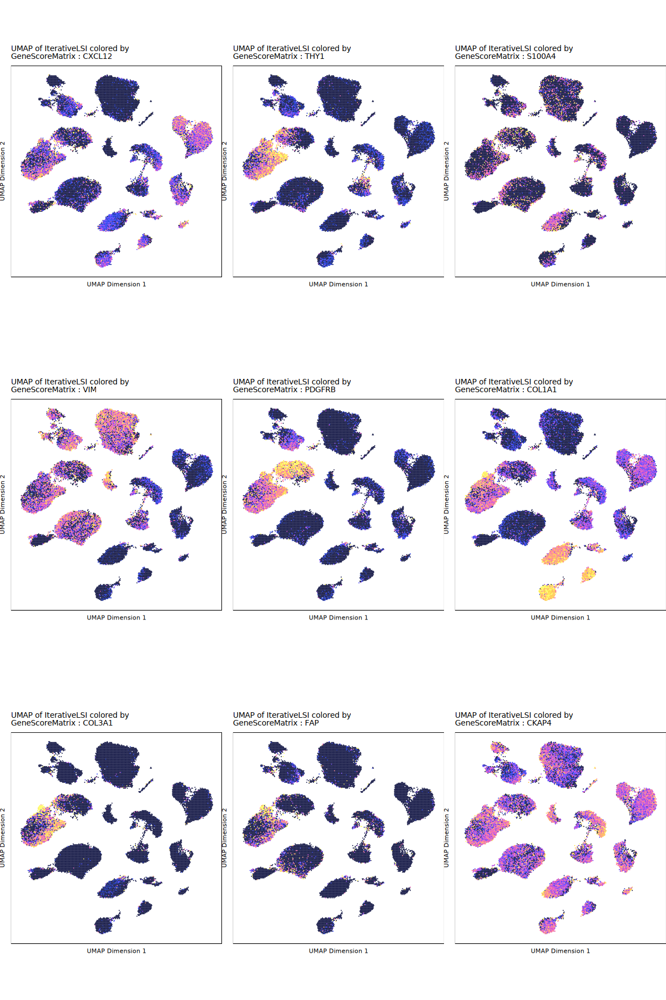

In [8]:
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 15, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

In [9]:
plotPDF(plotList = p, 
    name = "Plot-UMAP-Marker-Genes-Fibroblast.pdf", 
    ArchRProj = proj, 
    addDOC = FALSE, width = 5, height = 5)

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!



Getting ImputeWeights

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc8237804395-Date-2025-02-25_Time-02-02-42.587323.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:02:43.141501 : 



Imputing Matrix

Using weights on disk

Using weights on disk

Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 
9 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc8237804395-Date-2025-02-25_Time-02-02-42.587323.log



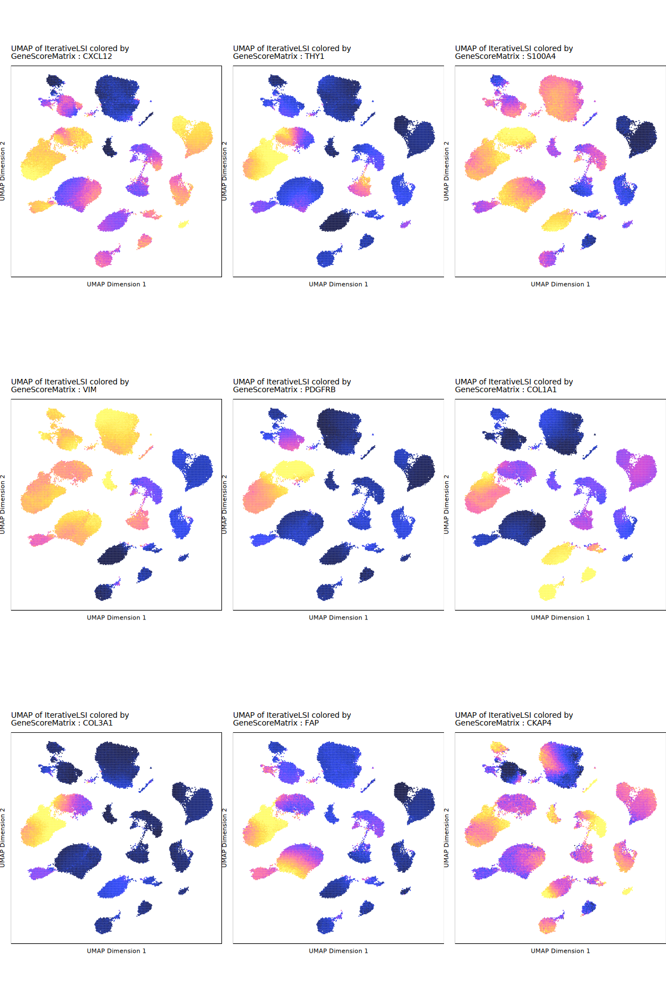

In [25]:
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = getImputeWeights(proj)
)
options(repr.plot.height = 15, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

In [10]:
# markerGenes - Endothelial内皮细胞
markerGenes <- c(
    "KDR", "ENG", "PECAM1", "ESM1", "VWF"
)

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-7ea49f136d8c-Date-2025-03-05_Time-12-55-47.707989.log
If there is an issue, please report to github with logFile!



Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-03-05 12:55:48.851959 : 



Plotting Embedding

1 
2 
3 
4 
5 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-7ea49f136d8c-Date-2025-03-05_Time-12-55-47.707989.log



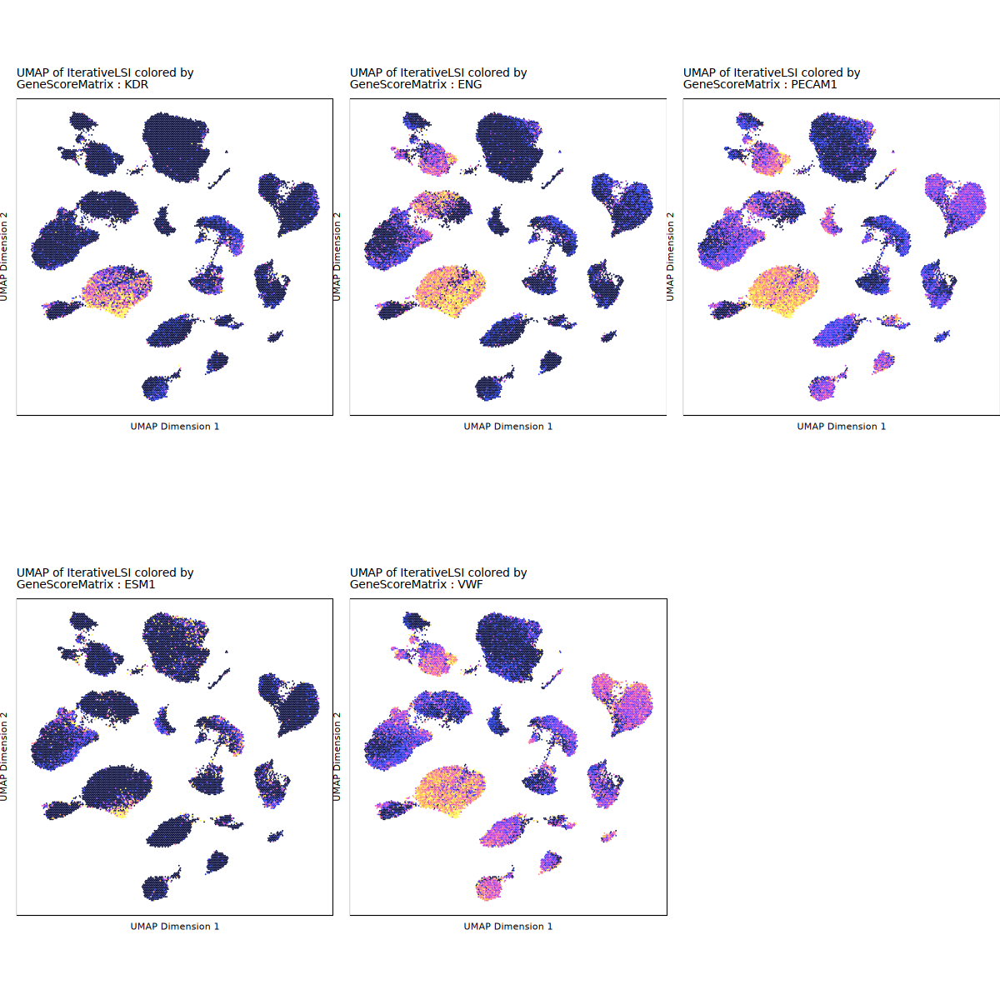

In [11]:
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

In [12]:
plotPDF(plotList = p, 
    name = "Plot-UMAP-Marker-Genes-Endothelial.pdf", 
    ArchRProj = proj, 
    addDOC = FALSE, width = 5, height = 5)

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!



Getting ImputeWeights

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc82400d7b18-Date-2025-02-25_Time-02-03-34.768432.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:03:35.237617 : 



Imputing Matrix

Using weights on disk

Using weights on disk



R_zmq_msg_send errno: 4 strerror: Interrupted system call


Plotting Embedding

1 
2 
3 
4 
5 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc82400d7b18-Date-2025-02-25_Time-02-03-34.768432.log



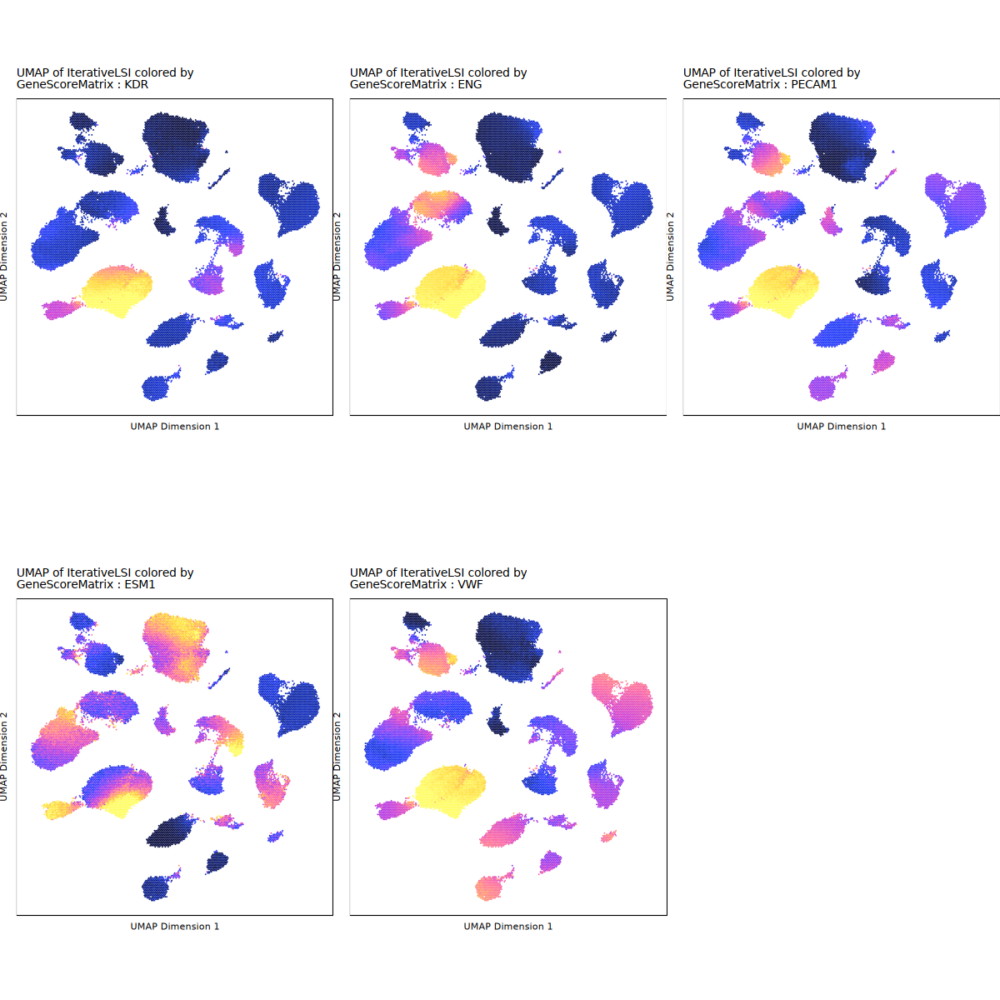

In [28]:
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = getImputeWeights(proj)
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

In [13]:
# markerGenes - T cell
markerGenes <- c(
    "CD3D", "CD8A", "TBX21", "IL7R", "CD3E", "CD3G", "CD4", "CD8A", "CD8B"
)

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-7ea4913976f9e-Date-2025-03-05_Time-12-56-38.746578.log
If there is an issue, please report to github with logFile!



Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-03-05 12:56:40.522439 : 



Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 
9 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-7ea4913976f9e-Date-2025-03-05_Time-12-56-38.746578.log



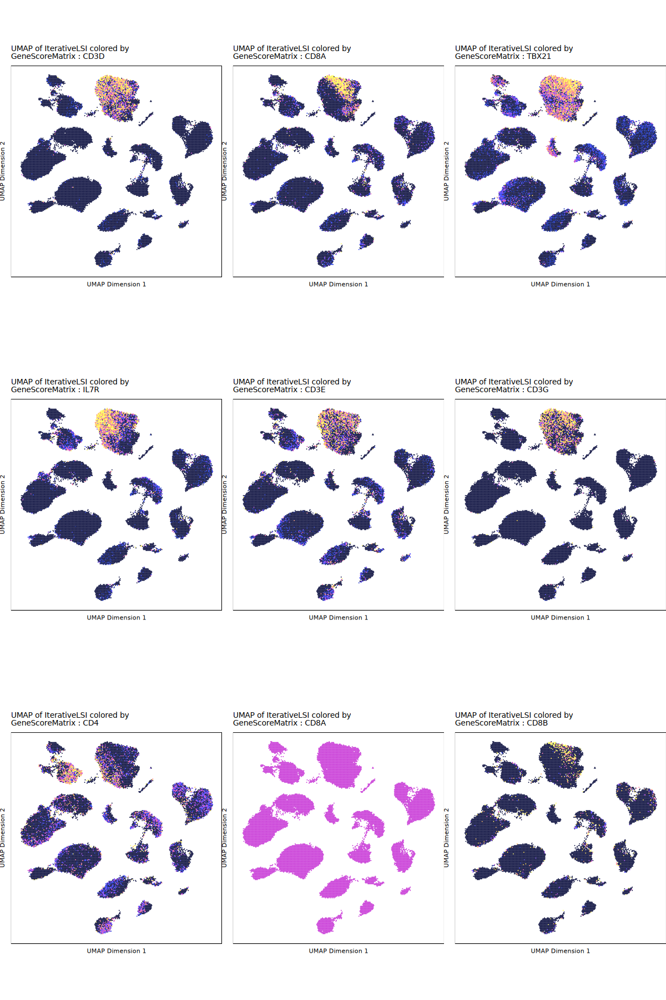

In [14]:
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 15, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

In [15]:
plotPDF(plotList = p, 
    name = "Plot-UMAP-Marker-Genes-T.pdf", 
    ArchRProj = proj, 
    addDOC = FALSE, width = 5, height = 5)

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!



Getting ImputeWeights

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc82295918a-Date-2025-02-25_Time-02-04-22.463356.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:04:22.68665 : 



Imputing Matrix

Using weights on disk

Using weights on disk

Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 
9 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc82295918a-Date-2025-02-25_Time-02-04-22.463356.log



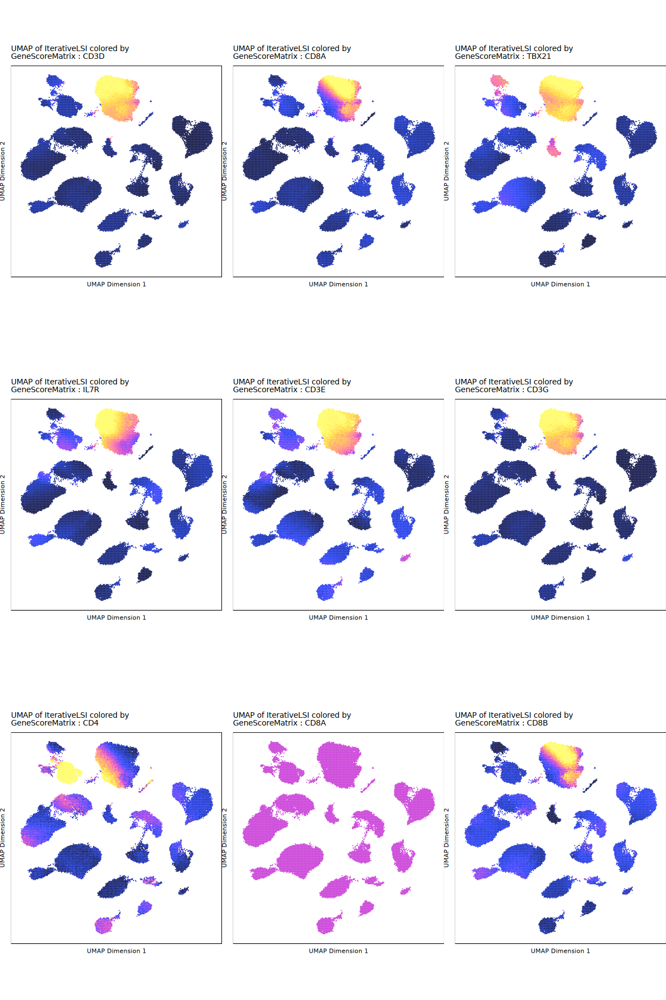

In [31]:
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = getImputeWeights(proj)
)
options(repr.plot.height = 15, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

In [16]:
# markerGenes - B cell
markerGenes <- c(
    "PAX5", "CD19", "MS4A1", "CD79A", "CD79B"
)

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-7ea4924c10bd3-Date-2025-03-05_Time-12-57-31.563916.log
If there is an issue, please report to github with logFile!



Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-03-05 12:57:31.930868 : 



Plotting Embedding

1 
2 
3 
4 
5 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-7ea4924c10bd3-Date-2025-03-05_Time-12-57-31.563916.log



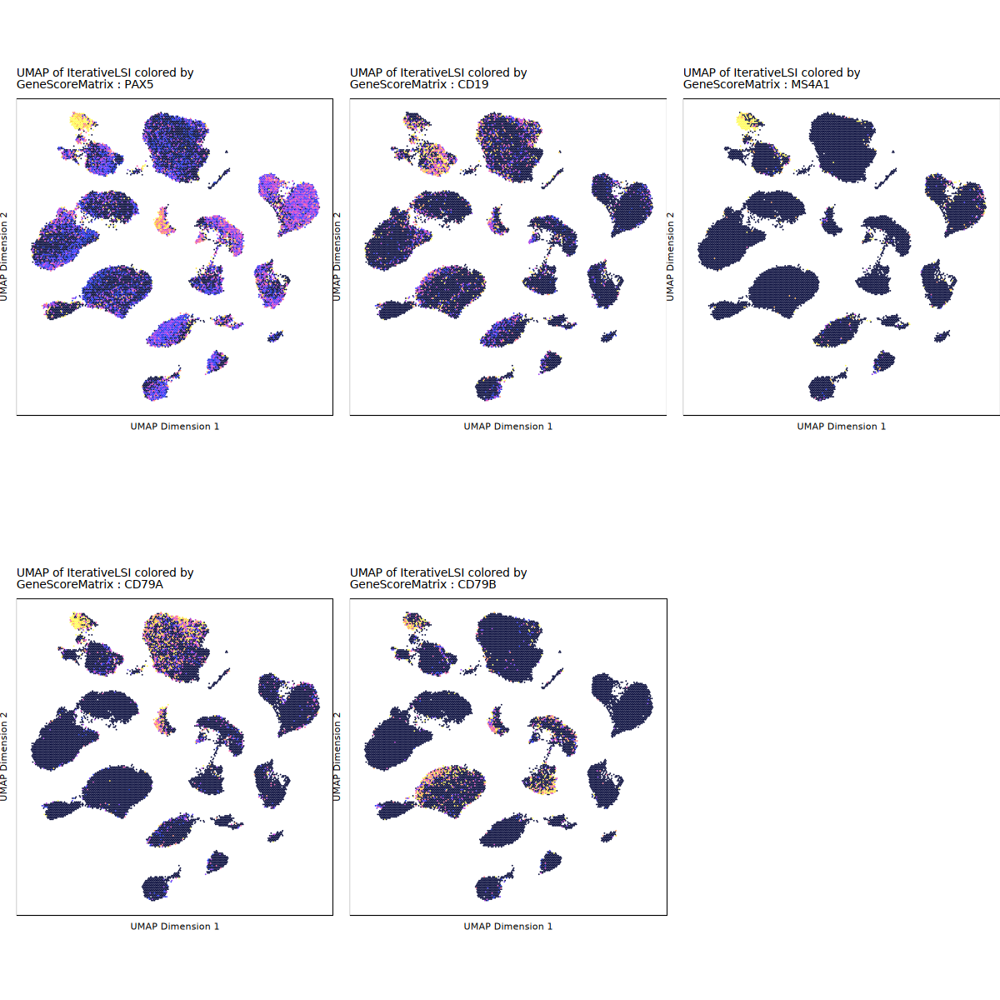

In [17]:
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

In [18]:
plotPDF(plotList = p, 
    name = "Plot-UMAP-Marker-Genes-B.pdf", 
    ArchRProj = proj, 
    addDOC = FALSE, width = 5, height = 5)

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!



Getting ImputeWeights

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc8254a3bfdb-Date-2025-02-25_Time-02-05-02.929598.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:05:03.155431 : 



Imputing Matrix

Using weights on disk

Using weights on disk

Plotting Embedding

1 
2 
3 
4 
5 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc8254a3bfdb-Date-2025-02-25_Time-02-05-02.929598.log



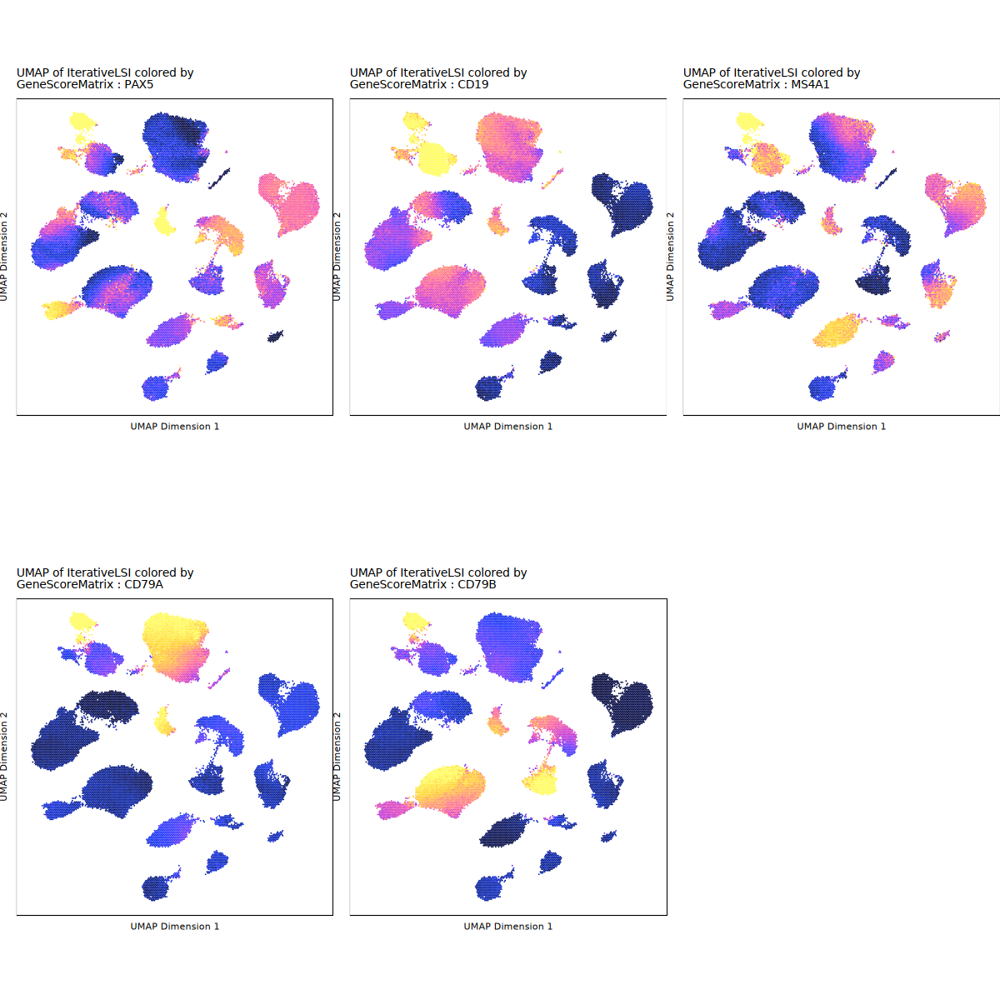

In [34]:
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = getImputeWeights(proj)
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

In [19]:
# markerGenes - 髓系细胞 Myeliod
markerGenes <- c(
    "ITGAM", "ITGAX", "CD14", "CD68"
)

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-7ea495217ceb5-Date-2025-03-05_Time-12-58-07.474171.log
If there is an issue, please report to github with logFile!



Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-03-05 12:58:07.776955 : 



Plotting Embedding

1 
2 
3 
4 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-7ea495217ceb5-Date-2025-03-05_Time-12-58-07.474171.log



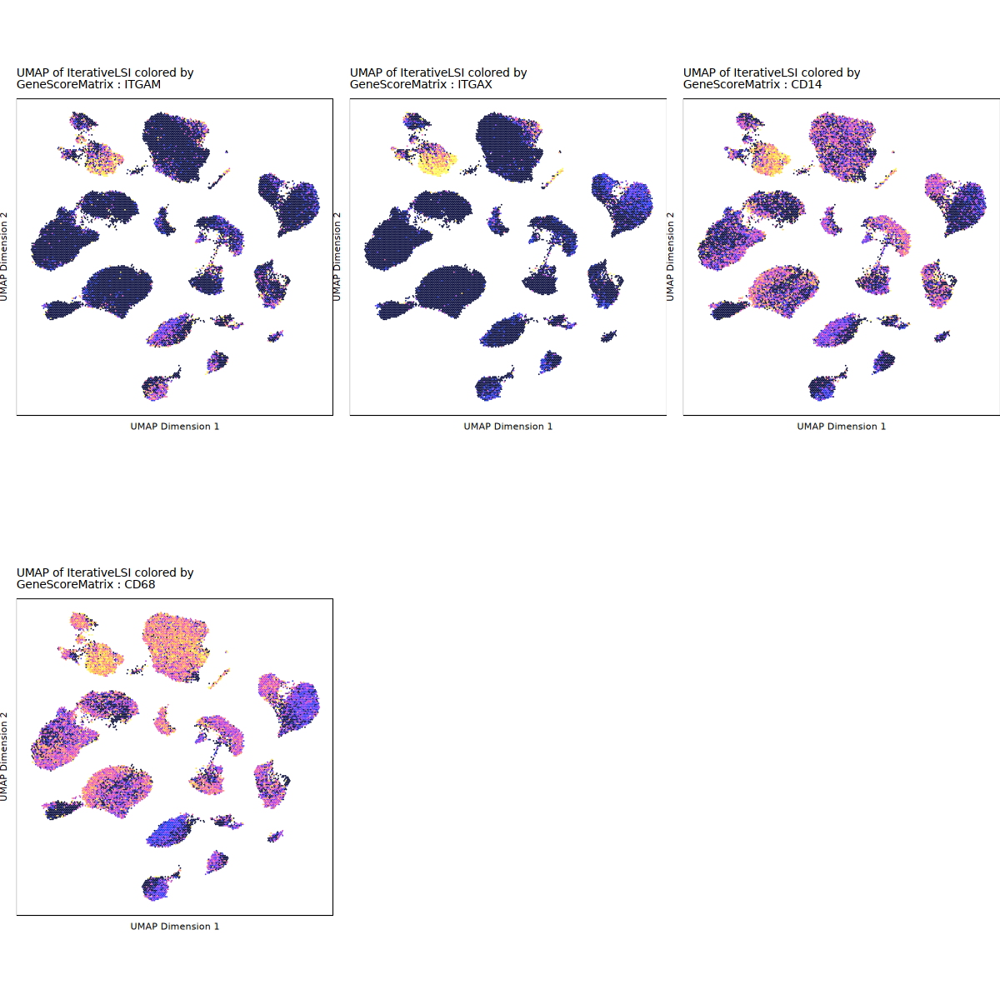

In [20]:
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

In [21]:
plotPDF(plotList = p, 
    name = "Plot-UMAP-Marker-Genes-Myeliod.pdf", 
    ArchRProj = proj, 
    addDOC = FALSE, width = 5, height = 5)

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!



Getting ImputeWeights

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc8263d8b60b-Date-2025-02-25_Time-02-05-35.625994.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:05:35.852989 : 



Imputing Matrix

Using weights on disk

Using weights on disk

Plotting Embedding

1 
2 
3 
4 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc8263d8b60b-Date-2025-02-25_Time-02-05-35.625994.log



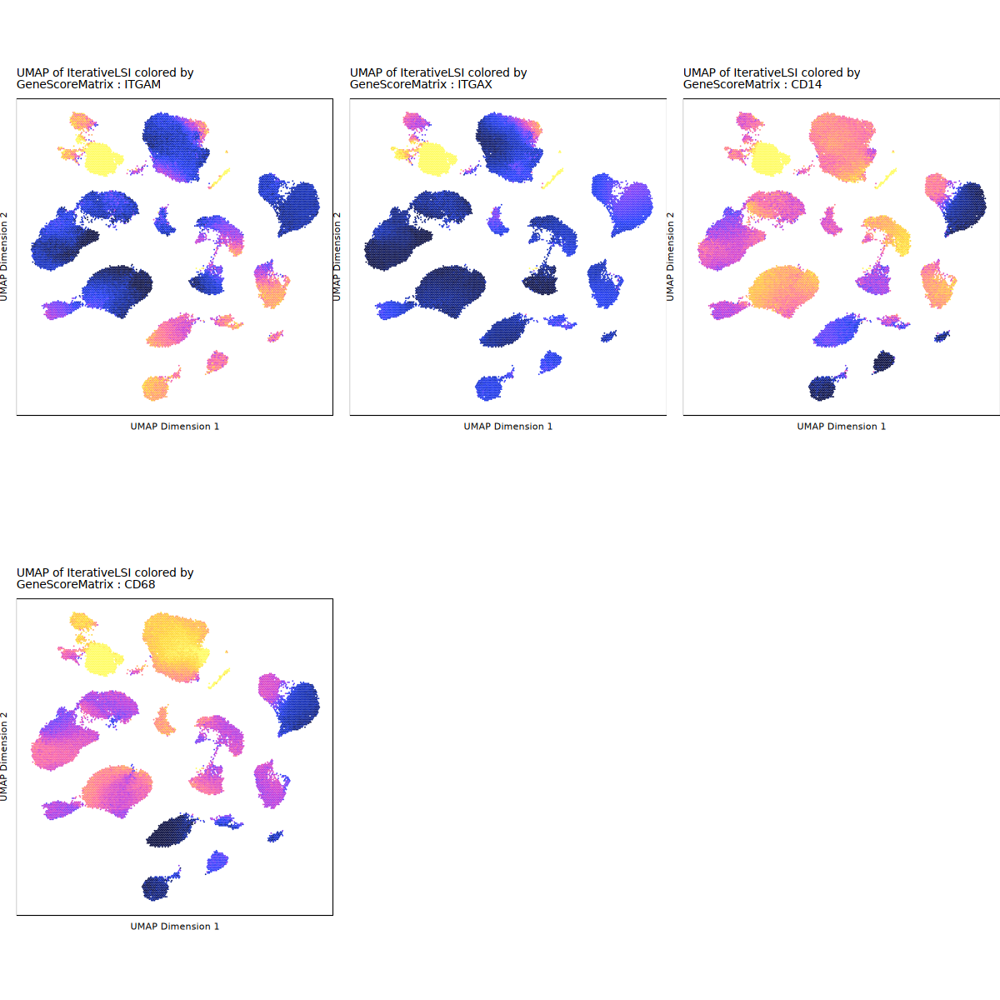

In [37]:
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = getImputeWeights(proj)
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

In [22]:
# markerGenes - 浆细胞 plasma
markerGenes <- c(
    "CD38", "IGLL5", "SDC1", "XBP1", "IRF4"
)

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-7ea49702357a1-Date-2025-03-05_Time-12-58-34.267176.log
If there is an issue, please report to github with logFile!



Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-03-05 12:58:34.505421 : 



Plotting Embedding

1 
2 
3 
4 
5 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-7ea49702357a1-Date-2025-03-05_Time-12-58-34.267176.log



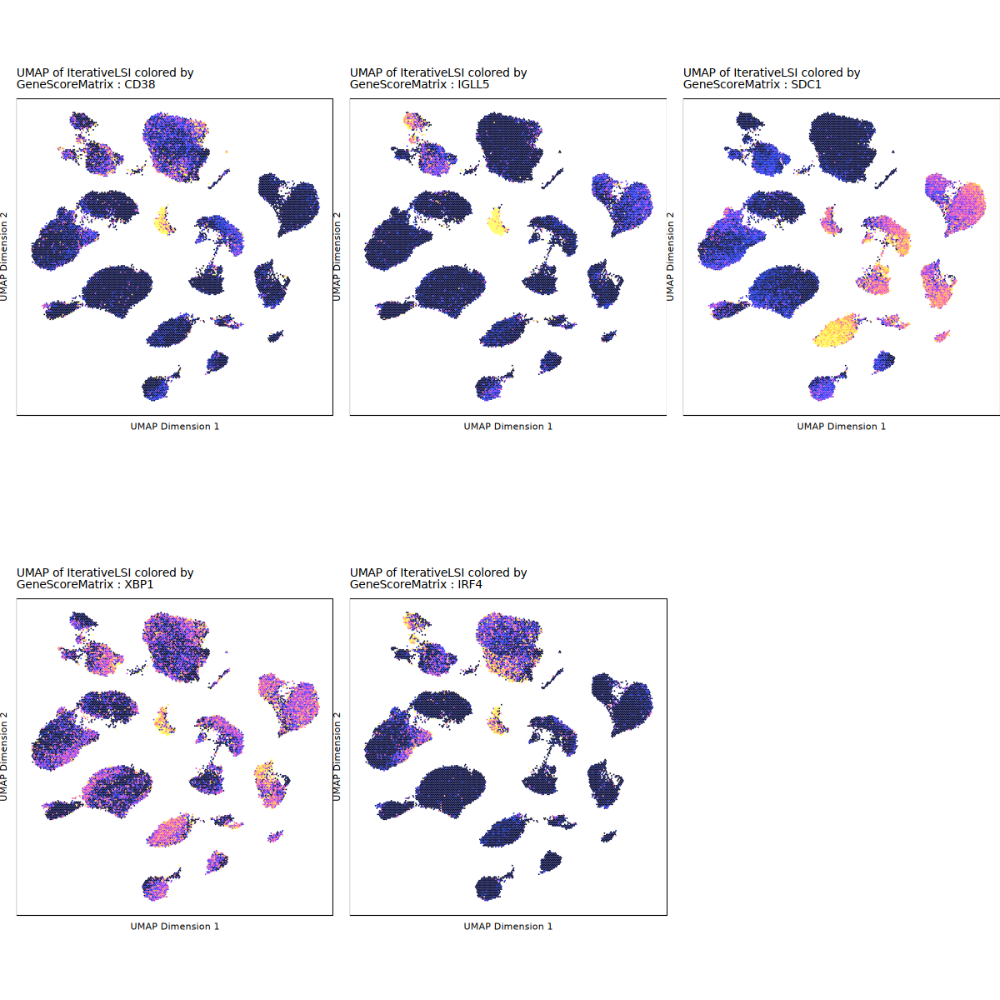

In [23]:
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

In [24]:
plotPDF(plotList = p, 
    name = "Plot-UMAP-Marker-Genes-Plasma.pdf", 
    ArchRProj = proj, 
    addDOC = FALSE, width = 5, height = 5)

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!



Getting ImputeWeights

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc82745b7965-Date-2025-02-25_Time-02-06-04.767259.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:06:05.055512 : 



Imputing Matrix

Using weights on disk

Using weights on disk

Plotting Embedding

1 
2 
3 
4 
5 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc82745b7965-Date-2025-02-25_Time-02-06-04.767259.log



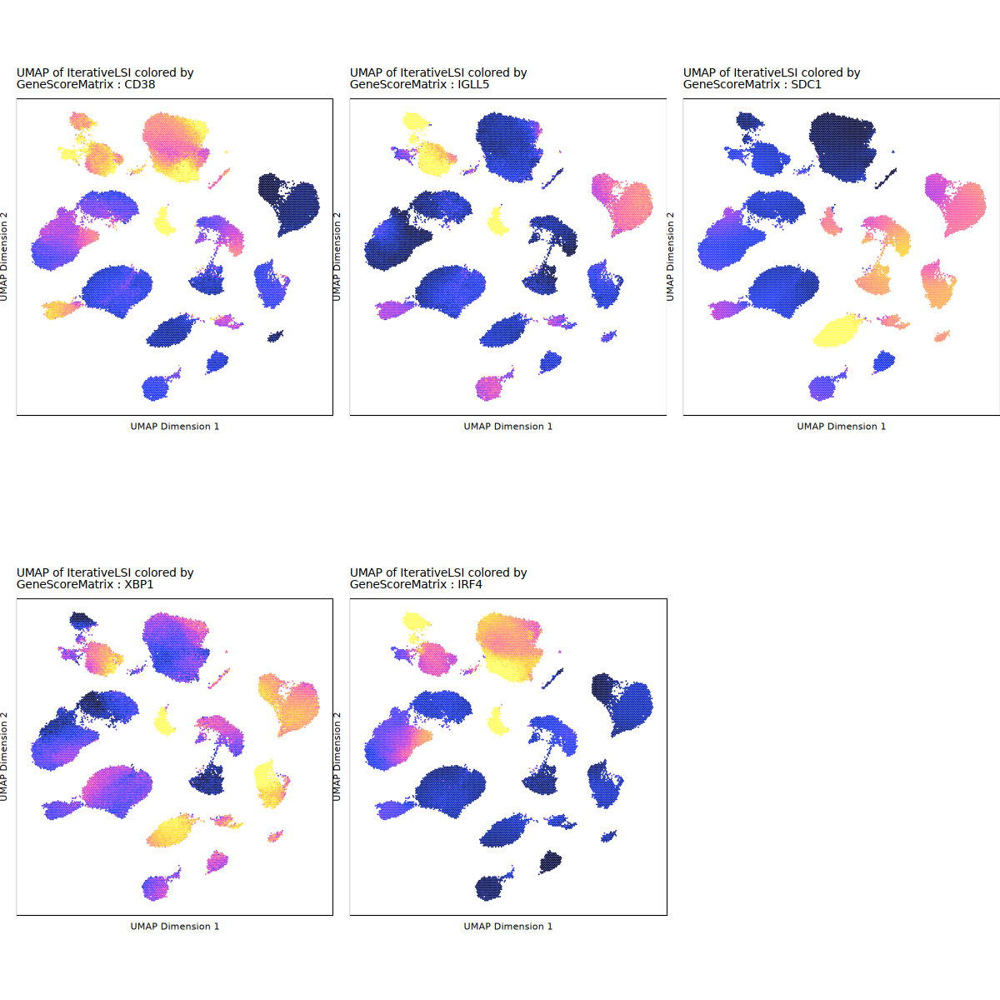

In [40]:
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = getImputeWeights(proj)
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

In [25]:
# markerGenes - Perivascular cell围血管细胞
markerGenes <- c(
    "PDGFRB", "CSPG4", "ACTA2", "MCAM",
    "MYH11", "TAGLN", "CNN1", "ACTA2",
    "RGS5", "DES", "PDGFRA"
)

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-7ea496a6c07fa-Date-2025-03-05_Time-12-59-02.495214.log
If there is an issue, please report to github with logFile!



Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-03-05 12:59:02.85524 : 



Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 
9 
10 
11 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-7ea496a6c07fa-Date-2025-03-05_Time-12-59-02.495214.log



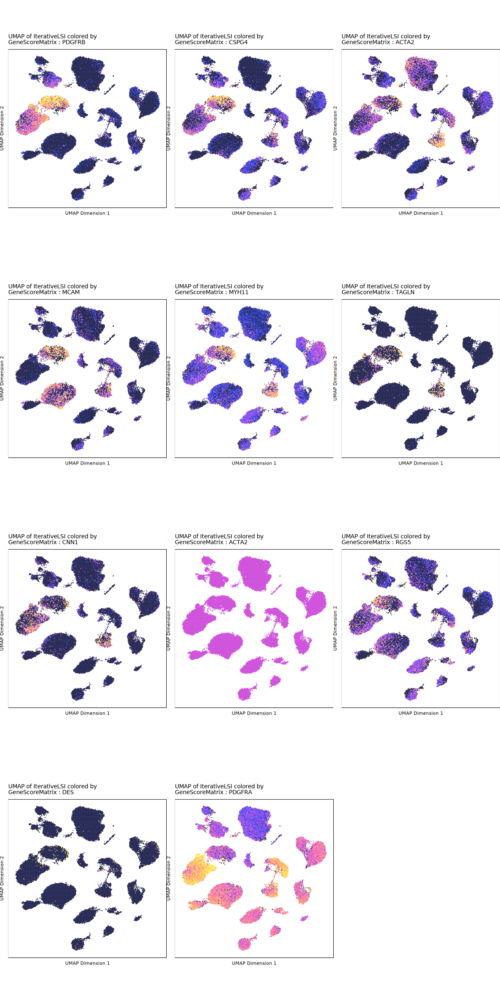

In [26]:
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 20, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

In [27]:
plotPDF(plotList = p, 
    name = "Plot-UMAP-Marker-Genes-Perivascular.pdf", 
    ArchRProj = proj, 
    addDOC = FALSE, width = 5, height = 5)

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!



Getting ImputeWeights

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc8239086be9-Date-2025-02-25_Time-02-07-03.782722.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:07:04.333685 : 



Imputing Matrix

Using weights on disk

Using weights on disk

Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 
9 
10 
11 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc8239086be9-Date-2025-02-25_Time-02-07-03.782722.log



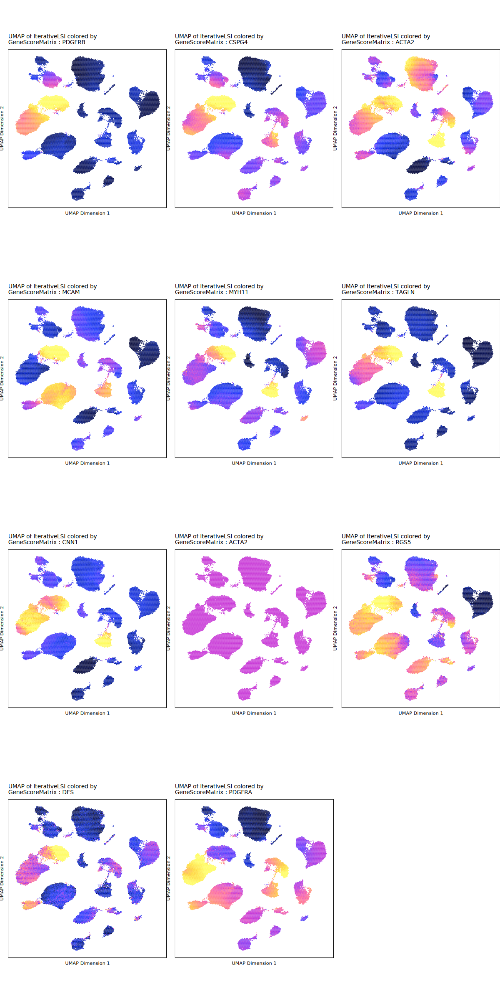

In [43]:
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = getImputeWeights(proj)
)
options(repr.plot.height = 20, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

In [28]:
# markerGenes - Mast cell 肥大细胞
markerGenes <- c(
    "KIT", "FCER1A", "TPSAB1", 
    "CPA3", "MS4A2", "HDC", 
    "GATA2", "TPSB2"
)

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-7ea49ef1b994-Date-2025-03-05_Time-13-00-11.600327.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-03-05 13:00:11.887645 : 



Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-7ea49ef1b994-Date-2025-03-05_Time-13-00-11.600327.log



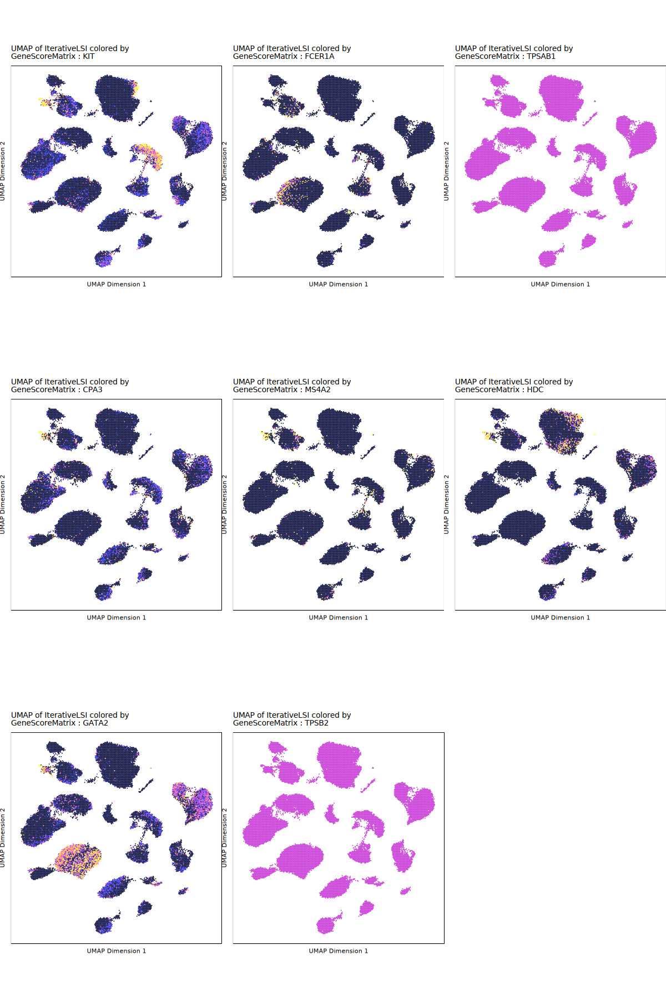

In [29]:
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 15, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

In [30]:
plotPDF(plotList = p, 
    name = "Plot-UMAP-Marker-Genes-Mast.pdf", 
    ArchRProj = proj, 
    addDOC = FALSE, width = 5, height = 5)

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!

Plotting Ggplot!



Getting ImputeWeights

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc8244c16880-Date-2025-02-25_Time-02-08-13.913999.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:08:14.139827 : 



Imputing Matrix

Using weights on disk

Using weights on disk

Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc8244c16880-Date-2025-02-25_Time-02-08-13.913999.log



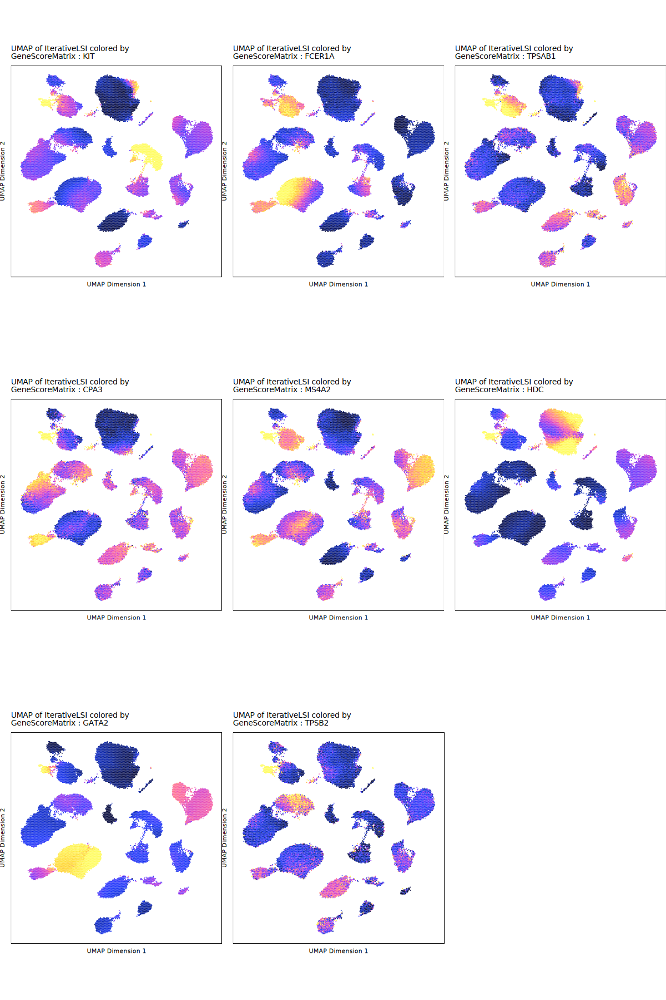

In [46]:
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = getImputeWeights(proj)
)
options(repr.plot.height = 15, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

15分类的差异项

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc82519fe2af-Date-2025-02-25_Time-02-08-51.652969.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding

ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:08:52.171406 : 



Plotting Embedding

1 
2 
3 
4 
5 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc82519fe2af-Date-2025-02-25_Time-02-08-51.652969.log



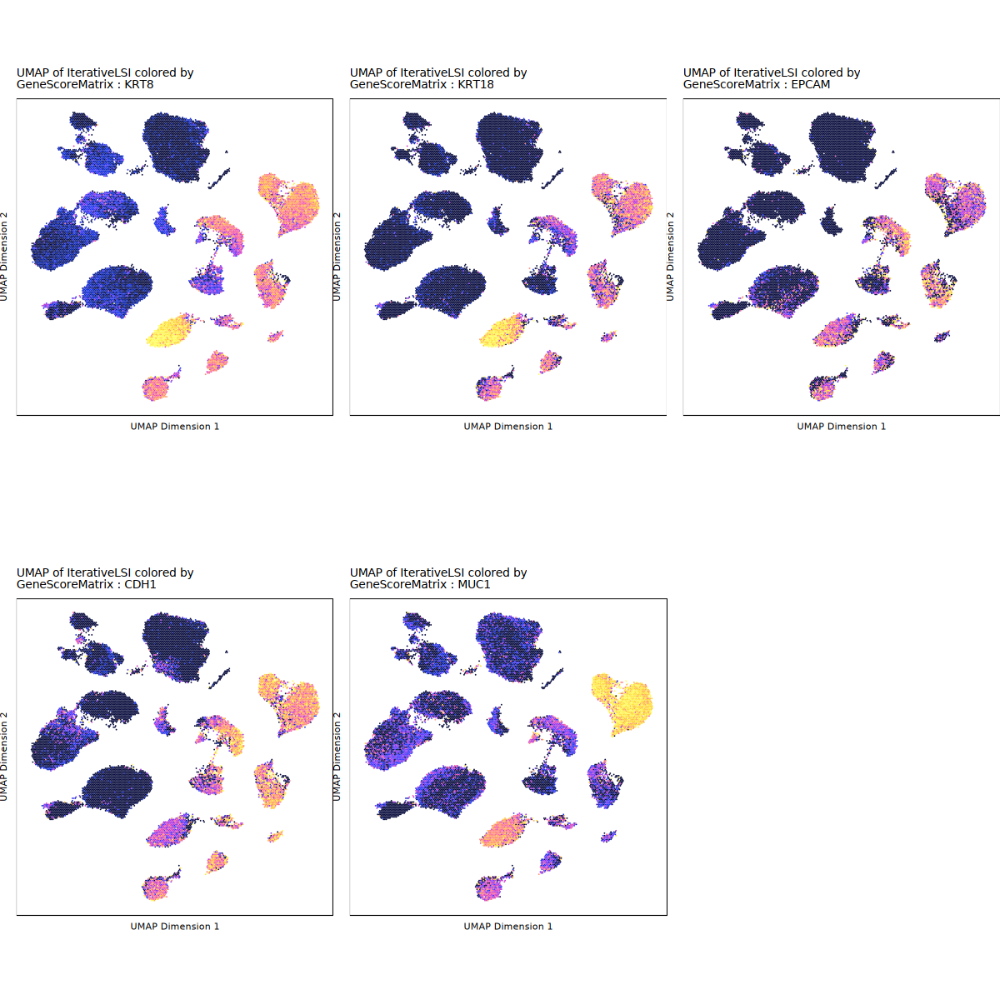

In [47]:
# Epithelial
markerGenes <- c(
    "KRT8", "KRT18", "EPCAM", "CDH1", "MUC1"
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc824980dc76-Date-2025-02-25_Time-02-09-09.543451.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:09:09.75763 : 



Plotting Embedding

1 
2 
3 
4 
5 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc824980dc76-Date-2025-02-25_Time-02-09-09.543451.log



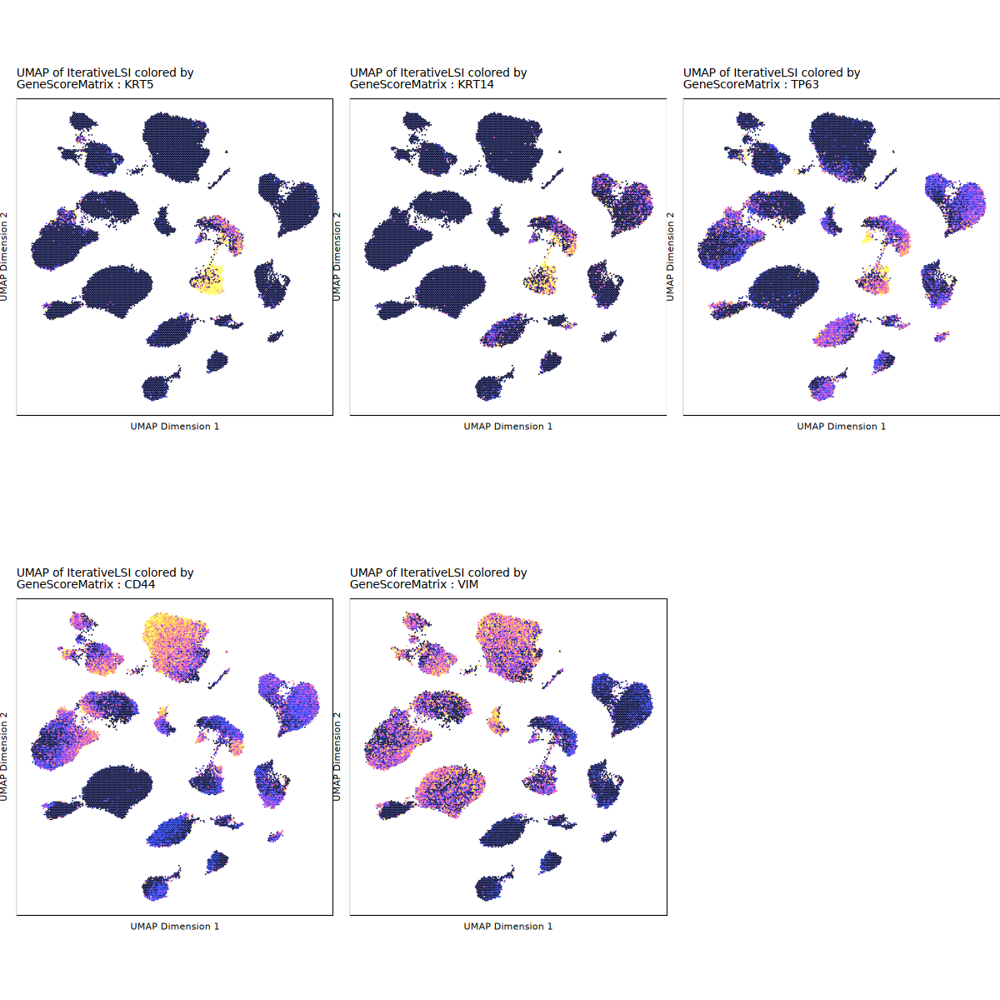

In [48]:
# Basal
markerGenes <- c(
    "KRT5", "KRT14", "TP63", "CD44", "VIM"
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc826042b8a7-Date-2025-02-25_Time-02-09-32.426816.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:09:32.65062 : 



Plotting Embedding

1 
2 
3 
4 
5 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc826042b8a7-Date-2025-02-25_Time-02-09-32.426816.log



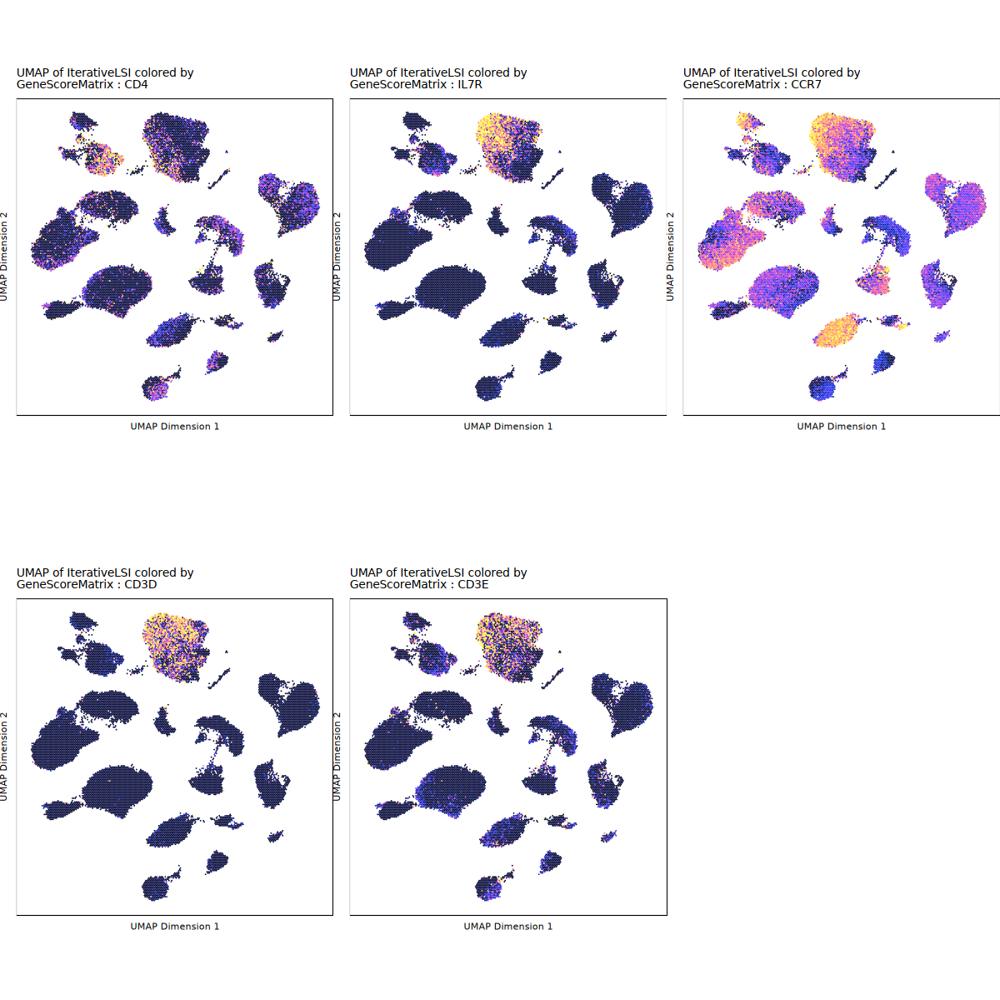

In [49]:
# CD4T cells
markerGenes <- c(
    "CD4", "IL7R", "CCR7", "CD3D", "CD3E"
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc823e4b388c-Date-2025-02-25_Time-02-09-47.581804.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:09:47.805552 : 



Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc823e4b388c-Date-2025-02-25_Time-02-09-47.581804.log



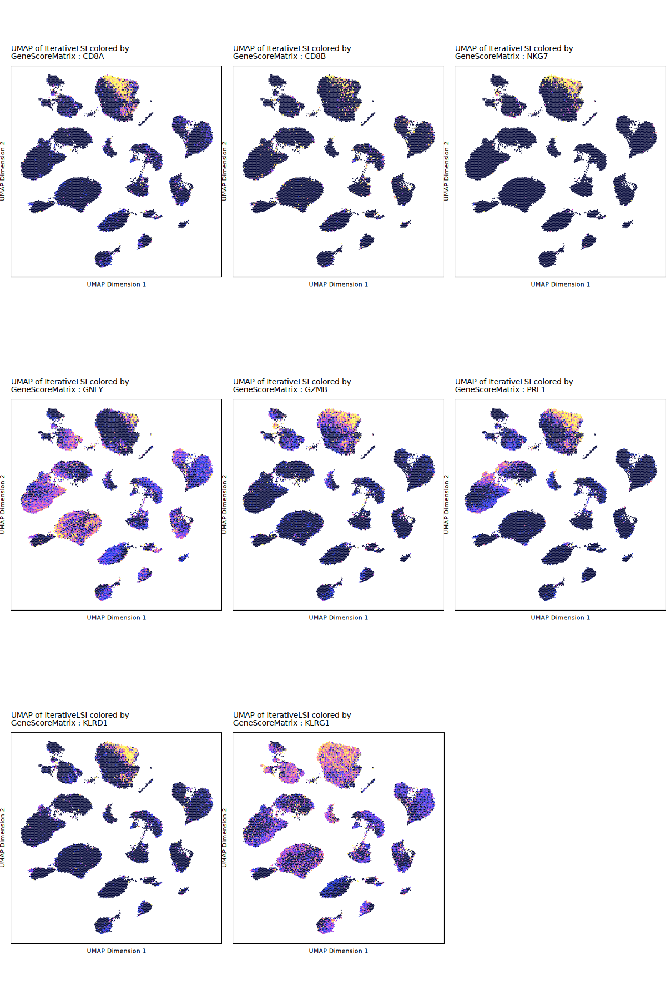

In [50]:
# CD8T & NK cells
markerGenes <- c(
    "CD8A", "CD8B", "NKG7", "GNLY", "GZMB", "PRF1", "KLRD1", "KLRG1"
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 15, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc82448ab3f7-Date-2025-02-25_Time-02-10-12.02495.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:10:12.644968 : 



Plotting Embedding

1 
2 
3 
4 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc82448ab3f7-Date-2025-02-25_Time-02-10-12.02495.log



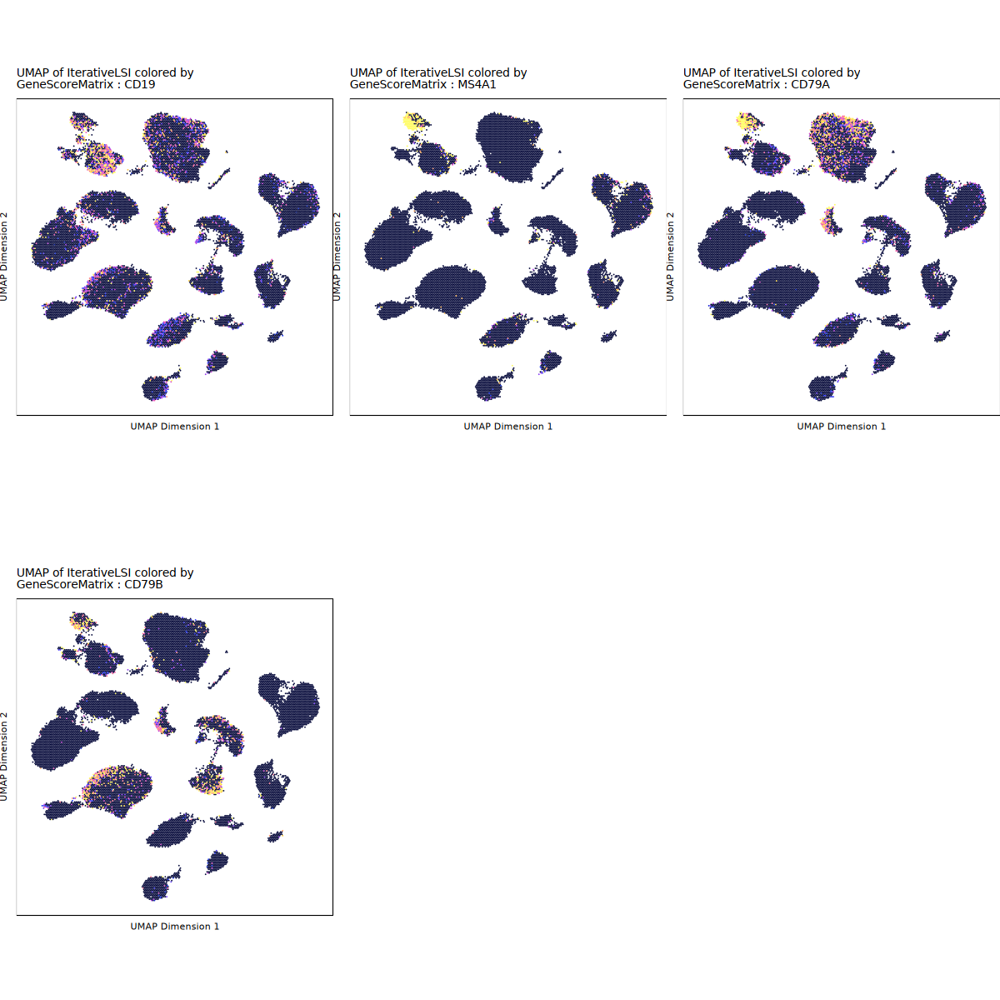

In [51]:
# B cells
markerGenes <- c(
    "CD19", "MS4A1", "CD79A", "CD79B"
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc826793cb2b-Date-2025-02-25_Time-02-10-29.816948.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:10:30.036838 : 



Plotting Embedding

1 
2 
3 
4 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc826793cb2b-Date-2025-02-25_Time-02-10-29.816948.log



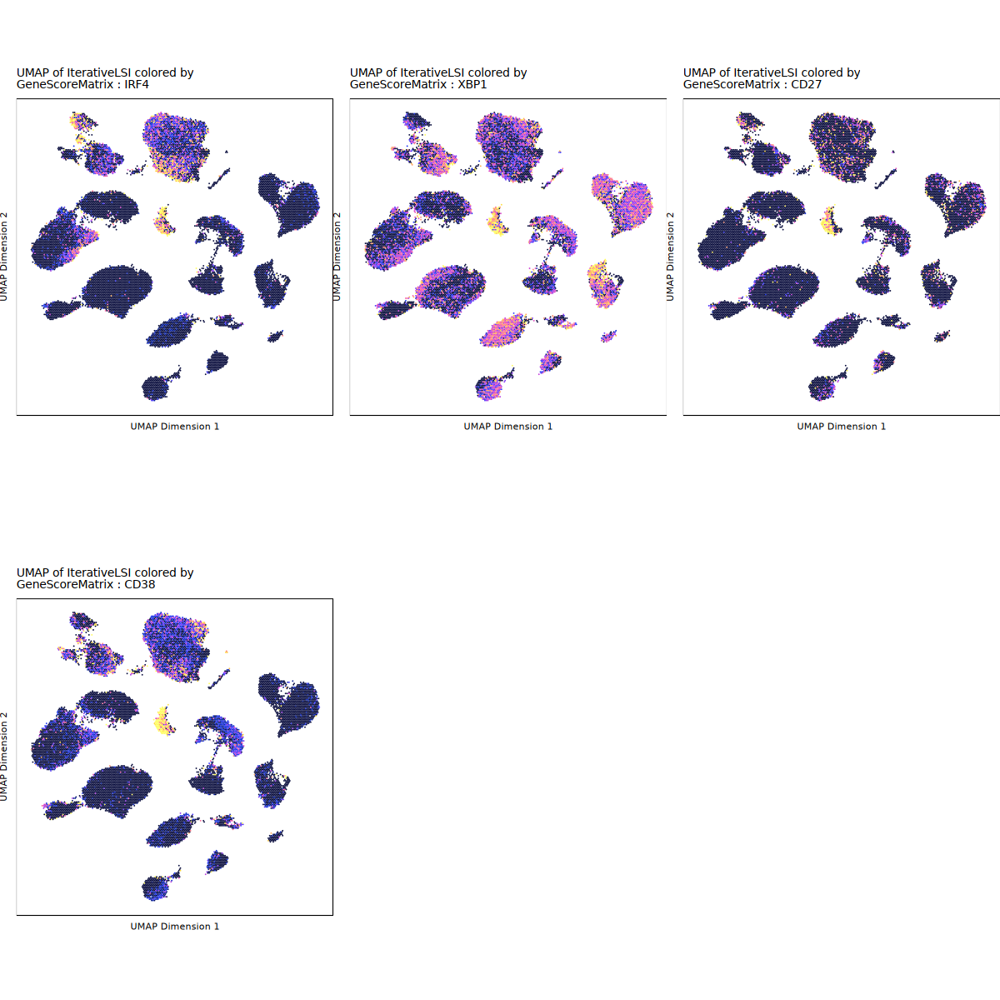

In [52]:
# Plasmablasts
markerGenes <- c(
    "IRF4", "XBP1", "CD27", "CD38"  
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc825891e615-Date-2025-02-25_Time-02-10-42.294552.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:10:42.510041 : 



Plotting Embedding

1 
2 
3 
4 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc825891e615-Date-2025-02-25_Time-02-10-42.294552.log



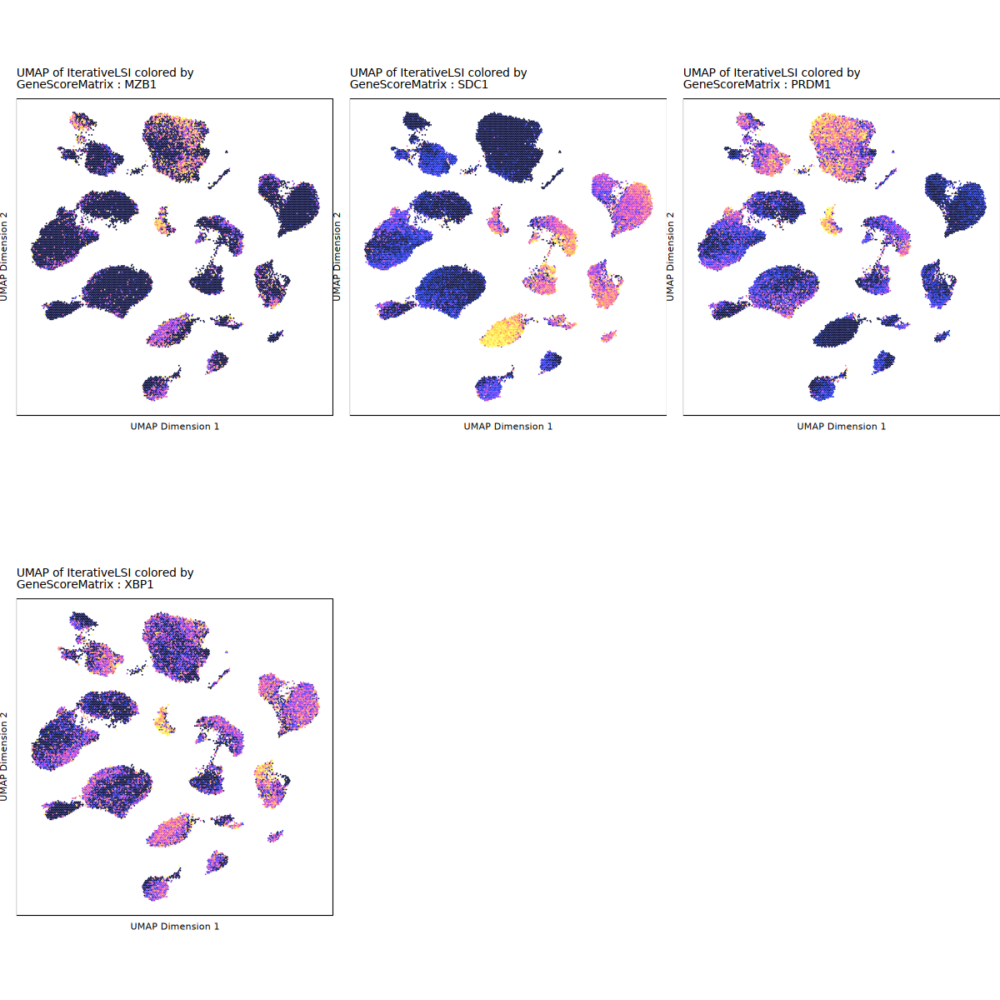

In [53]:
# Plasma cells
markerGenes <- c(
    "MZB1", "SDC1", "PRDM1", "XBP1"
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc82548e8098-Date-2025-02-25_Time-02-10-57.506872.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:10:57.752982 : 



Plotting Embedding

1 
2 
3 
4 
5 
6 
7 
8 
9 
10 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc82548e8098-Date-2025-02-25_Time-02-10-57.506872.log



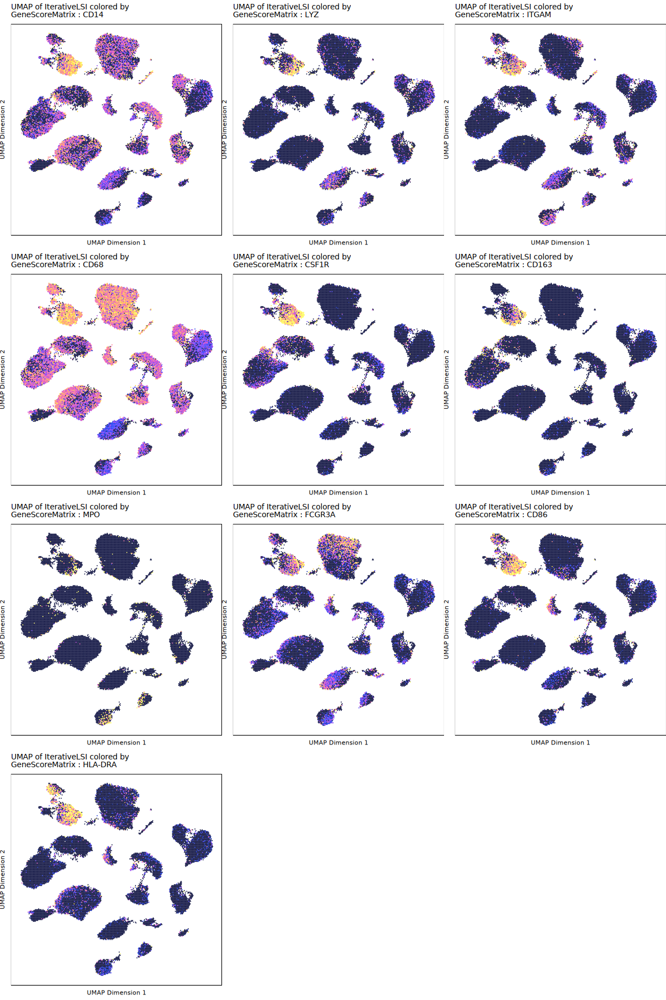

In [54]:
# Myeloid cells
markerGenes <- c(
    "CD14",     # Monocytes/macrophages
    "LYZ",      # Lysozyme, a marker for monocytes and macrophages
    "ITGAM",    # Integrin alpha M (CD11b), commonly expressed in myeloid cells
    "CD68",     # Marker for macrophages
    "CSF1R",    # Colony stimulating factor 1 receptor, important for macrophage lineage
    "CD163",    # Scavenger receptor, a marker for macrophages
    "MPO",      # Myeloperoxidase, expressed in granulocytes
    "FCGR3A",   # CD16, a marker for NK cells and monocytes
    "CD86",     # Costimulatory molecule found on antigen-presenting cells
    "HLA-DRA"   # MHC class II molecule, a marker for antigen-presenting cells
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 15, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc82ed5dd38-Date-2025-02-25_Time-02-11-32.581265.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:11:32.821778 : 



Plotting Embedding

1 
2 
3 
4 
5 
6 
7 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc82ed5dd38-Date-2025-02-25_Time-02-11-32.581265.log



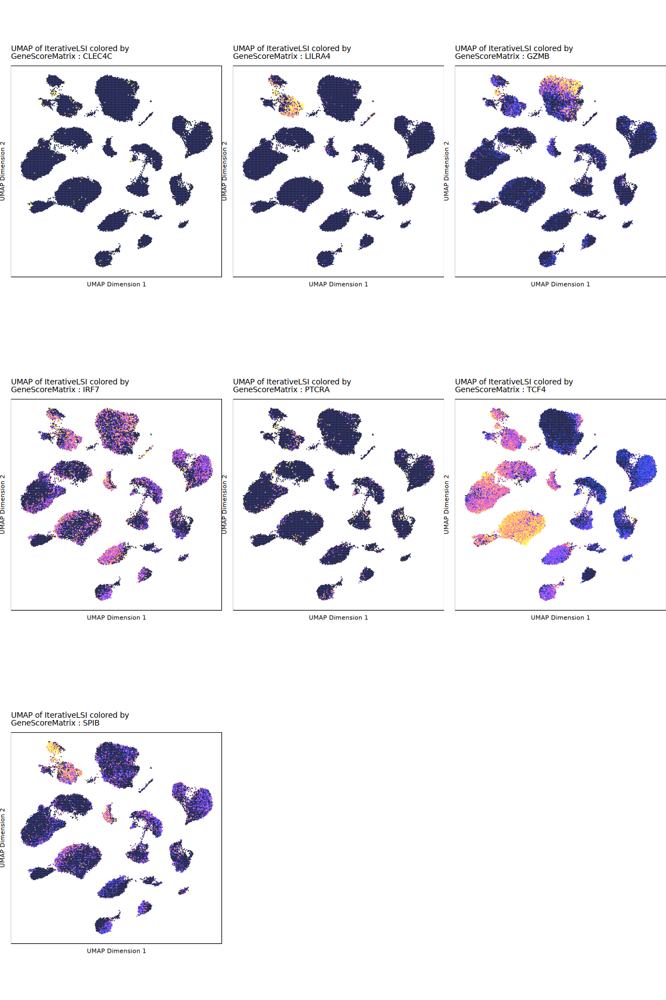

In [55]:
# pDC
markerGenes <- c(
    "CLEC4C",   # BDCA-2, specific to pDCs
    "LILRA4",   # ILT7, another pDC-specific marker
    "GZMB",     # Granzyme B, expressed in activated pDCs
    "IRF7",     # Interferon regulatory factor 7, key in type I interferon production
    "PTCRA",    # Pre-T cell receptor alpha, also expressed in pDCs
    "TCF4",     # Transcription factor 4, involved in pDC development
    "SPIB"      # Transcription factor specific to pDCs
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 15, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc821a9481bb-Date-2025-02-25_Time-02-11-59.993318.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:12:00.233696 : 



Plotting Embedding

1 
2 
3 
4 
5 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc821a9481bb-Date-2025-02-25_Time-02-11-59.993318.log



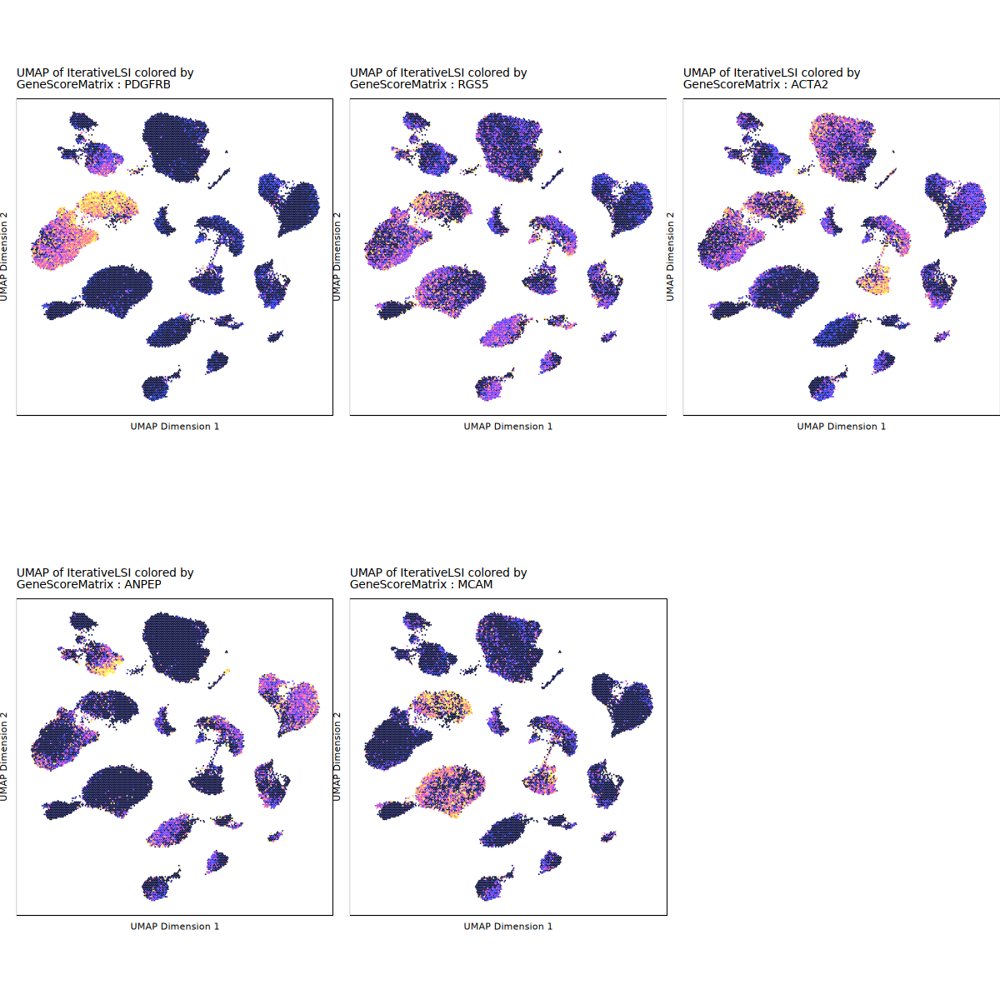

In [56]:
# Pericyte
markerGenes <- c(
    "PDGFRB",  # Platelet-Derived Growth Factor Receptor Beta
    "RGS5",    # Regulator of G-Protein Signaling 5
    "ACTA2",   # Alpha Smooth Muscle Actin
    "ANPEP",   # Alanyl Aminopeptidase (CD13)
    "MCAM"     # Melanoma Cell Adhesion Molecule (CD146)
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc8243d89d2-Date-2025-02-25_Time-02-12-17.153936.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:12:17.38658 : 



Plotting Embedding

1 
2 
3 
4 
5 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc8243d89d2-Date-2025-02-25_Time-02-12-17.153936.log



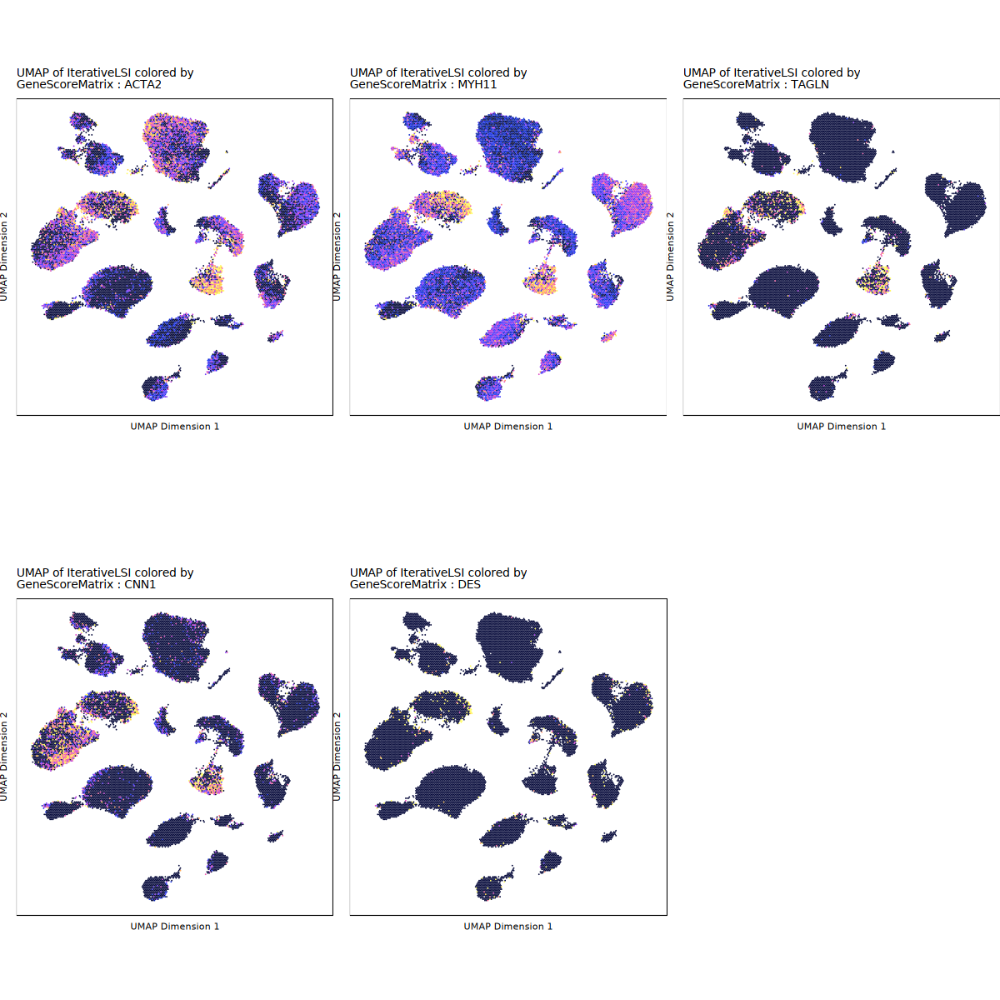

In [57]:
# Smooth muscle
markerGenes <- c(
  "ACTA2",   # Alpha Smooth Muscle Actin
  "MYH11",   # Myosin Heavy Chain 11
  "TAGLN",   # Transgelin (SM22-alpha)
  "CNN1",    # Calponin 1
  "DES"      # Desmin
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))

ArchR logging to : ArchRLogs/ArchR-plotEmbedding-28dc824461d730-Date-2025-02-25_Time-02-12-38.572449.log
If there is an issue, please report to github with logFile!

Getting UMAP Embedding



ColorBy = GeneScoreMatrix

Getting Matrix Values...

2025-02-25 02:12:39.12193 : 



Plotting Embedding

1 
2 
3 
4 
5 
6 


ArchR logging successful to : ArchRLogs/ArchR-plotEmbedding-28dc824461d730-Date-2025-02-25_Time-02-12-38.572449.log



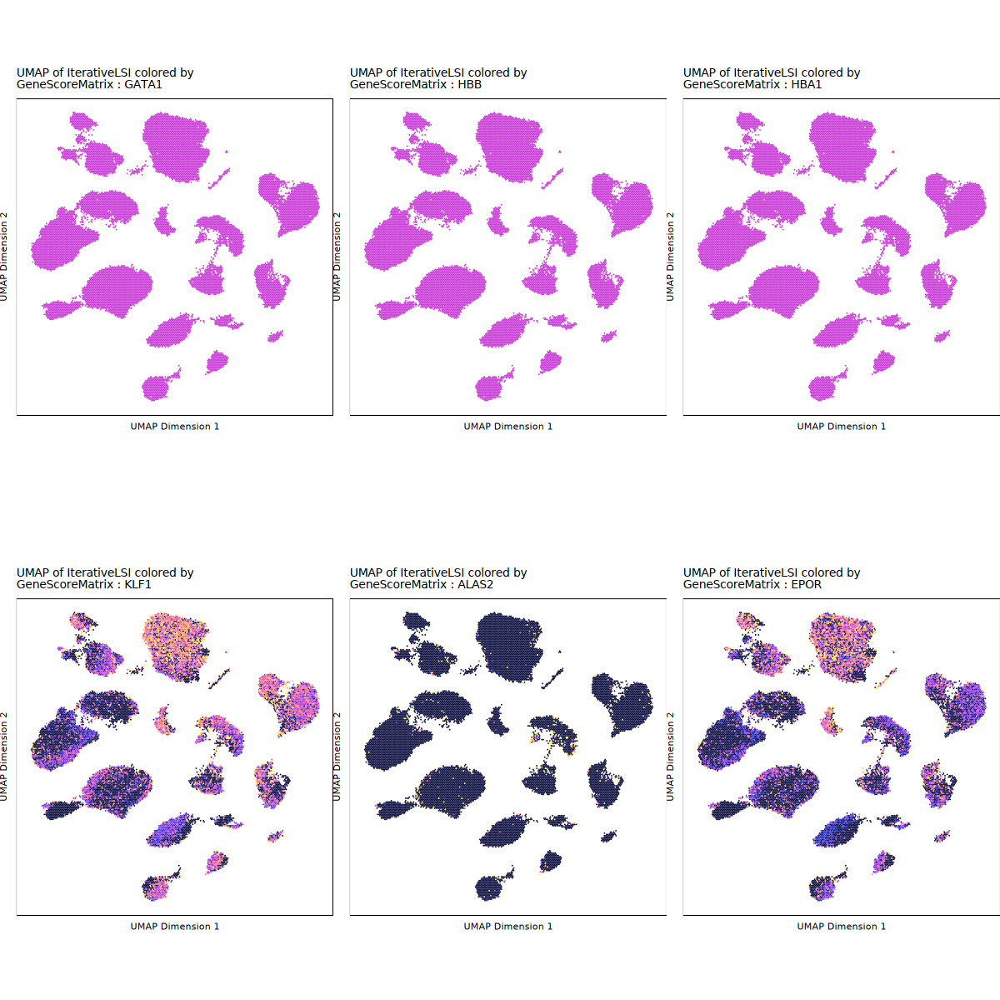

In [58]:
# Erythroid
markerGenes <- c(
  "GATA1",   # GATA Binding Protein 1
  "HBB",     # Hemoglobin Subunit Beta
  "HBA1",    # Hemoglobin Subunit Alpha 1
  "KLF1",    # Kruppel-Like Factor 1
  "ALAS2",   # 5'-Aminolevulinate Synthase 2
  "EPOR"     # Erythropoietin Receptor
)
# 基因得分UMAP可视化
p <- plotEmbedding(
    ArchRProj = proj, 
    colorBy = "GeneScoreMatrix", 
    name = markerGenes, 
    embedding = "UMAP",
    quantCut = c(0.01, 0.95),
    imputeWeights = NULL
)
options(repr.plot.height = 10, repr.plot.width = 10)
p2 <- lapply(p, function(x){
    x + guides(color = FALSE, fill = FALSE) + 
    theme_ArchR(baseSize = 6.5) +
    theme(plot.margin = unit(c(0, 0, 0, 0), "cm")) +
    theme(
        axis.text.x=element_blank(), 
        axis.ticks.x=element_blank(), 
        axis.text.y=element_blank(), 
        axis.ticks.y=element_blank()
    )
})
do.call(cowplot::plot_grid, c(list(ncol = 3),p2))